In [1]:
## basic
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image

## statistics
from scipy.stats import zscore
from scipy.stats import ttest_rel ## paired t-test
from scipy.stats import ttest_ind ## two-sample t-test


## system
import os
import pickle
import warnings
warnings.filterwarnings("ignore")

##
import PyComplexHeatmap as pyc
import umap.umap_ as umap
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import KernelPCA
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score

In [2]:
!conda install 

Retrieving notices: ...working... done

CondaValueError: too few arguments, must supply command line package specs or --file



## Define Helper Functions

In [3]:
def scale(df,
          method="standard"):
    
    if method == "standard":
        scaler = StandardScaler()
        df_scaled = pd.DataFrame(scaler.fit_transform(df),
                                 index = df.index,
                                 columns = df.columns)
        return df_scaled

    if method == "double_z":
        df_scaled = df.apply(zscore,axis=1).\
            apply(zscore, axis=0)

    else:
        df_scaled = df

    return df_scaled

def umap_wrapper(df,
                 df_meta=None,
                 n_pca=10,
                 remove_PC1=True,
                 n_neighbors=15,
                 n_umap=3,
                 learning_rate=1,
                 min_dist=0.1,
                 spread = 1,
                 metric="euclidean",
                 random_state=42):

    assert min_dist <= spread

    print(f"Input data dimension: {df.shape}")

    if df_meta is not None:
        print(f"Input meta-data dimension: {df_meta.shape}")
    else:
        print("No meta-info")
    
    ## perform linear PCA
    pca = PCA(n_components=n_pca)
    df_pca = pd.DataFrame(pca.fit_transform(df),
                          columns = ["PC" + str(i) for i in range(1, n_pca+1)],
                          index = df.index)

    ## UMAP
    umap_embedding = umap.UMAP(n_neighbors=n_neighbors,
                               n_components=n_umap, 
                               learning_rate=learning_rate,
                               min_dist=min_dist,
                               spread = spread,
                               metric=metric,
                               random_state=random_state)
    ## remove "PC1"
    if remove_PC1:
        df_umap = pd.DataFrame(umap_embedding.fit_transform(df_pca.drop("PC1",axis=1)),
                           columns = ["UMAP" + str(i) for i in range(1, n_umap+1)],
                           index = df_pca.index)
    
        print(f"Dimension after UMAP: {df_umap.shape}")
    else:
        df_umap = pd.DataFrame(umap_embedding.fit_transform(df_pca),
                           columns = ["UMAP" + str(i) for i in range(1, n_umap+1)],
                           index = df_pca.index)

    if df_meta is not None:
        ## merge meta-data
        df_umap = pd.merge(df_meta, df_umap, left_index=True, right_index=True)
        df_pca = pd.merge(df_meta, df_pca, left_index=True, right_index=True)
    
        print(f"Dimension after merging: {df_umap.shape}")

    return df_umap, df_pca

def age_binned(age):
    
    if age <= 45:
        return "age < 45"
    if 45 < age <= 55:
        return " 45 < age <= 55"
    if 55 < age <= 65:
         return " 55 < age <= 65"
    if 65 < age <= 75:
         return " 65 < age <= 75"
    
    if 75 < age <= 85:
         return " 75 < age <= 85"

    return "> 85"

## Load Data

In [4]:
with open('/screening/notebooks/zhuang/summer_2024/data/region_ids.pkl', 'rb') as f:
        region_ids = pickle.load(f)

with open('/screening/notebooks/zhuang/summer_2024/data/df_ldt.pkl', 'rb') as f:
        df_ldt = pickle.load(f)

## Query region meta-data to obtain "positive_control" regions
v6_region = "/screening/data/methylation/sandbox_pipeline/assets/mafband_v2023_12_23/msre_regions.tsv"
pos_control = pd.read_csv(v6_region, sep="\t").\
    query('merged_region_type == "HYPER_CONTROL"').\
    loc[:,"region_id"].\
    reset_index(drop=True)
pos_control_in_s3 = [i for i in pos_control if i in region_ids]

print(f"There are {len(pos_control_in_s3)} positive control regions in S3")

## subset data
df_cf = df_ldt.loc[:,["unique_sample_id","sample_group","age","sex", "histological_subtype", 'g360_max_maf_pct', 'tvf_max_maf_pct']+region_ids].\
    query('sample_group == "cancer_free"').\
    set_index("unique_sample_id")

## drop regions whose values are -5 across all samples
no_molecule = [col for col in df_cf.columns if (df_cf[col]==-5).all()]
print(f"There are {len(no_molecule)} regions with no molecules")
df_cf = df_cf.drop(no_molecule,axis=1)

#df_cf = pd.merge(df_cf, lung_MB_S3_V4, left_index = True, right_index = True, how = "left")

print(f"Cancer_free data dimension: {df_cf.shape}")

There are 41 positive control regions in S3
There are 8208 regions with no molecules
Cancer_free data dimension: (995, 19140)


## Load Region Data

In [5]:
## p80-p100
## drop NaN
## inf = high ~ 10
## sens_threshold = 50
## lod = -1 = bad

#top = 5000
snr = pd.read_csv(os.getcwd()+"/../data/snrs.tsv",sep="\t").\
    query('sample_group == "lung"').\
    replace(np.inf, 40).\
    sort_values("snr_p100",ascending=False).\
    set_index("region_id")
    

LoD = pd.read_csv(os.getcwd()+"/../data/tvf_max_maf_pct_90_lods.tsv",sep="\t").\
    query('sample_group_cancer == "lung" and lod != -1 and sens_threshold==50 and lod <= 1').\
    set_index("region_id").\
    assign(log_lod = lambda df: np.log(df['lod']))

region_anno = pd.merge(LoD, snr, left_index=True, right_index=True, how="left")

## V6
v6_regions = pd.read_csv(v6_region, sep="\t").\
    query('merged_region_type != "HYPER_CONTROL"').\
    assign(panel = "V6").\
    loc[:,["region_id","panel"]].\
    set_index("region_id")

## region annotation
region_anno["in_v6"] = ["yes" if i in v6_regions.index else "no" for i in region_anno.index]

## check coverage
region_anno["no_molecule"] = ["yes" if i in no_molecule else "no" for i in region_anno.index]

## regions of interest
regions_of_interest = list(region_anno.index)

print(f"There are {len(regions_of_interest)} regions of interest")


There are 1028 regions of interest


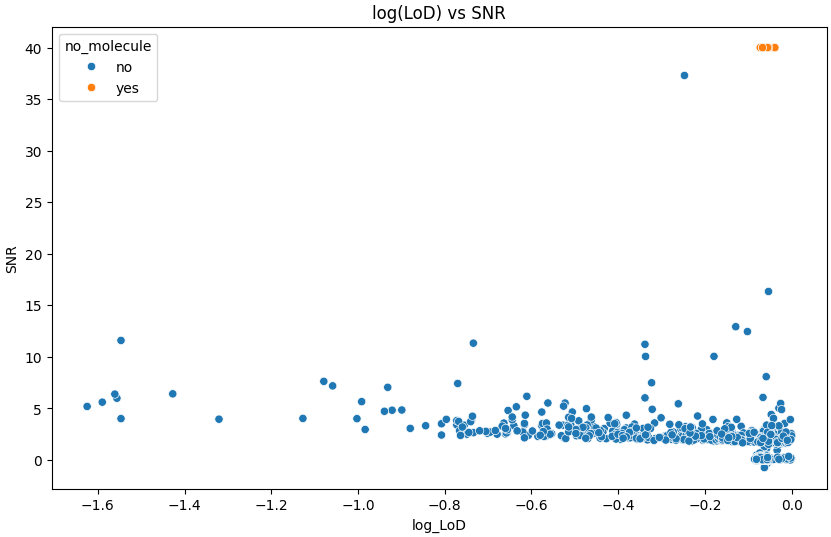

In [6]:
fig, axes = plt.subplots(figsize=(10,6))
        
with plt.style.context('_classic_test_patch'):
        
    sns.scatterplot(x="log_lod",
                    y="snr_p100",
                    hue="no_molecule",
                    data=region_anno)
    axes.set_xlabel("log_LoD")
    axes.set_ylabel("SNR")
    axes.set_title("log(LoD) vs SNR")

In [7]:
region_anno.head()

,sens_threshold,lod,maf_arg,sample_group_cancer,log_lod,sample_group,snr_p15,snr_p30,snr_p50,snr_p80,snr_p90,snr_p98,snr_p100,in_v6,no_molecule
region_id,,,,,,,,,,,,,,,
merged_1063,50,0.933,tvf_max_maf_pct,lung,-0.069350,lung,0.021951,0.088778,0.144192,0.203556,0.220116,0.232560,0.235573,yes,no
merged_1084,50,0.879,tvf_max_maf_pct,lung,-0.128970,lung,1.566865,1.790218,2.024377,2.172759,2.208378,2.214453,2.234390,yes,no
merged_1114,50,0.953,tvf_max_maf_pct,lung,-0.048140,lung,1.298919,1.611533,1.798833,1.902381,1.930828,1.951325,1.969295,yes,no
merged_1120,50,0.696,tvf_max_maf_pct,lung,-0.362406,lung,2.456439,2.873650,3.254021,3.236376,3.221483,3.185637,3.199183,yes,no
merged_1145,50,0.957,tvf_max_maf_pct,lung,-0.043952,lung,1.679814,2.347190,2.919942,3.302863,3.244055,3.181707,3.217006,yes,no


## More information

In [8]:
tvf2 = pd.read_csv("../data/tfv2gamma.tsv",sep="\t").\
    rename(columns={"value":"tumor_fraction"})

## for Cancer-free vs. CRC
mb = pd.read_csv("../data/merged.msre_mr_call.hdr.tsv",sep="\t")

tvf2_mb = pd.merge(tvf2, mb, on = ["runid","run_sample_id"], how="inner").\
    set_index("unique_sample_id").\
    drop(["runid", "run_sample_id", "norm_flavor", "metric", "hyper_residual_count_pos_ctrl", "model_name"], axis=1)


## merge to cancer-free samples
df_cf = pd.merge(df_cf, tvf2_mb, how="left", left_index=True, right_index=True).\
    assign(log_tumor_fraction = lambda df: np.log(df["tumor_fraction"]))

In [9]:
df_cf.head()

,sample_group,age,sex,histological_subtype,g360_max_maf_pct,tvf_max_maf_pct,s3_region_1,s3_region_2,s3_region_3,s3_region_4,...,merged_2711,merged_2712,merged_2713,merged_2714,merged_2716,tumor_fraction,methyl_score,threshold,methyl_call,log_tumor_fraction
unique_sample_id,,,,,,,,,,,,,,,,,,,,,
A088494401_231104_A01835_0165_AHK7GVDSX7,cancer_free,34.0,F,colo adenocarcinoma,NaN,NaN,-5.0,-5.000000,-5.0,-5.0,...,-3.814669,-5.0,-5.0,-5.000000,-3.723465,0.000087,-22.121883,-21.3192,0.0,-9.348961
A079777201_230922_A02056_0046_BHCYNKDSX7,cancer_free,73.0,M,colo adenocarcinoma,NaN,NaN,-5.0,-5.000000,-5.0,-5.0,...,-4.466951,-5.0,-5.0,-4.466951,-5.000000,0.000052,-21.808756,-21.3192,0.0,-9.865036
A085371001_230922_A02056_0046_BHCYNKDSX7,cancer_free,60.0,M,colo adenocarcinoma,NaN,NaN,-5.0,-5.000000,-5.0,-5.0,...,-3.634035,-5.0,-5.0,-5.000000,-5.000000,0.000087,-22.415353,-21.3192,0.0,-9.353458
A085436301_230922_A02048_0033_AHF2V3DSX7,cancer_free,62.0,F,colo adenocarcinoma,NaN,NaN,-5.0,-4.696608,-5.0,-5.0,...,-3.916498,-5.0,-5.0,-5.000000,-3.716782,0.004059,-21.509161,-21.3192,0.0,-5.506913
A085668501_230925_A02048_0034_BHCYMYDSX7,cancer_free,39.0,F,colo adenocarcinoma,NaN,NaN,-5.0,-5.000000,-5.0,-5.0,...,-3.411328,-5.0,-5.0,-4.067671,-3.561457,0.000070,-21.770641,-21.3192,0.0,-9.567700


## Preprocess Data

In [10]:
pdata_cf = ["sample_group", "age" ,"sex", "histological_subtype", "g360_max_maf_pct", "tvf_max_maf_pct", "tumor_fraction", "log_tumor_fraction", "methyl_score", "threshold", "methyl_call"]

## meta-data
df_cf_meta = df_cf.loc[:,pdata_cf]


## region score and scaling
df_cf_region = df_cf.drop(pdata_cf,axis=1)

df_cf_standard = scale(df_cf_region,
                       method = "standard")

print(df_cf_standard.shape)

df_cf_double_z = scale(df_cf_region,
                        method = "double_z")

print(df_cf_double_z.shape)

## subset regions to regions_of_interest
cols = [col for col in df_cf_standard.columns if col in regions_of_interest]
print(f"There are {len(cols)} regions of interest")

df_cf_standard_roi = df_cf_standard[cols]
df_cf_double_z_roi = df_cf_double_z[cols]

(995, 19134)
(995, 19134)
There are 827 regions of interest


### Median region score/standard scaling/double-z scores of each region

In [11]:
region_anno_all = pd.DataFrame().\
    assign(region_score_median = df_cf_region.apply(lambda x: np.median(x)),
           standard_median = df_cf_standard.apply(lambda x: np.median(x)),
           double_z_median = df_cf_double_z.apply(lambda x: np.median(x)),
           pos_control = lambda df: np.where(df.index.isin(pos_control_in_s3),1,0))
           

region_anno_all.head()

,region_score_median,standard_median,double_z_median,pos_control
s3_region_1,-5.0,-0.174817,-0.145685,0
s3_region_2,-5.0,-0.078679,0.027538,0
s3_region_3,-5.0,-0.044522,0.068033,0
s3_region_4,-5.0,-0.119528,-0.053956,0
s3_region_6,-5.0,-0.662087,-0.598984,0


In [12]:
## Add these information to "regions of interest"
region_anno = pd.merge(region_anno, region_anno_all, how="left", left_index=True, right_index=True)

region_anno.head()

,sens_threshold,lod,maf_arg,sample_group_cancer,log_lod,sample_group,snr_p15,snr_p30,snr_p50,snr_p80,snr_p90,snr_p98,snr_p100,in_v6,no_molecule,region_score_median,standard_median,double_z_median,pos_control
region_id,,,,,,,,,,,,,,,,,,,
merged_1063,50,0.933,tvf_max_maf_pct,lung,-0.069350,lung,0.021951,0.088778,0.144192,0.203556,0.220116,0.232560,0.235573,yes,no,-5.0,-0.031718,0.080133,0.0
merged_1084,50,0.879,tvf_max_maf_pct,lung,-0.128970,lung,1.566865,1.790218,2.024377,2.172759,2.208378,2.214453,2.234390,yes,no,-5.0,-0.523477,-0.471343,0.0
merged_1114,50,0.953,tvf_max_maf_pct,lung,-0.048140,lung,1.298919,1.611533,1.798833,1.902381,1.930828,1.951325,1.969295,yes,no,-5.0,-0.630055,-0.569908,0.0
merged_1120,50,0.696,tvf_max_maf_pct,lung,-0.362406,lung,2.456439,2.873650,3.254021,3.236376,3.221483,3.185637,3.199183,yes,no,-5.0,-0.466737,-0.412429,0.0
merged_1145,50,0.957,tvf_max_maf_pct,lung,-0.043952,lung,1.679814,2.347190,2.919942,3.302863,3.244055,3.181707,3.217006,yes,no,-5.0,-0.219110,-0.161848,0.0


## Linear PCA Explained Variance Ratio and Correlation with MAF

In [13]:
def pca_wrapper(df,
                maf=None,
                n=10):
    pca = PCA(n_components=n)
    
    df_pca = pd.DataFrame(pca.fit_transform(df),
                      index = df.index)    

    if maf:
        df_pca['maf'] = maf
    
        print(df_pca.columns[-1])
    
        maf_corr = df_pca.dropna().\
        iloc[:,:-1].\
        apply(lambda x: x.corr(df.iloc[:,-1]))
    
        var_ratio = pca.explained_variance_ratio_


        return var_ratio, maf_corr
    else:
        return pca.explained_variance_ratio_

### Samples

maf
maf
maf
maf


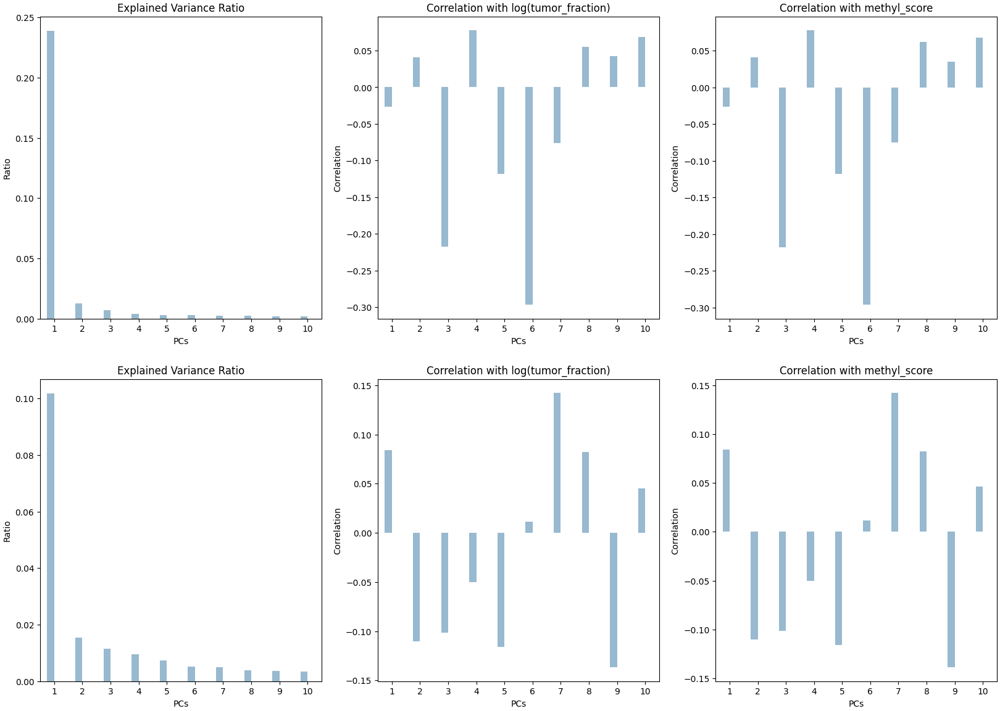

In [14]:
n = 10


var_ratio_z, log_tumor_fraction_corr_z = pca_wrapper(df_cf_double_z.drop([i for i in pos_control_in_s3 if i in df_cf_double_z.columns],axis=1),
                                                     maf = list(df_cf_meta['log_tumor_fraction']),
                                                     n = n)


_, methyl_score_corr_z = pca_wrapper(df_cf_double_z.drop([i for i in pos_control_in_s3 if i in df_cf_double_z.columns],axis=1),
                                     maf = list(df_cf_meta['methyl_score']),
                                     n = n)

var_ratio_standard, log_tumor_fraction_corr_standard = pca_wrapper(df_cf_standard.drop([i for i in pos_control_in_s3 if i in df_cf_standard.columns],axis=1),
                                                                   maf = list(df_cf_meta['log_tumor_fraction']),
                                                                   n = n)

_, methyl_score_corr_standard = pca_wrapper(df_cf_standard.drop([i for i in pos_control_in_s3 if i in df_cf_standard.columns],axis=1),
                                            maf = list(df_cf_meta['methyl_score']),
                                            n = n)


fig, axes = plt.subplots(2,3,figsize=(20,14))

with plt.style.context('_classic_test_patch'):

        ## first row = double-z
        sns.barplot(x = list(range(1, n+1)),
                    y = var_ratio_z,
                    width = 0.25,
                    alpha = 0.5,
                    align = "center",
                    ax = axes[0,0])
    
        axes[0,0].set_title("Explained Variance Ratio", fontsize=12)
        axes[0,0].set_xlabel("PCs", fontsize=10)
        axes[0,0].set_ylabel("Ratio", fontsize=10)

    
        sns.barplot(x = list(range(1, n+1)),
                    y = log_tumor_fraction_corr_z,
                    width = 0.25,
                    alpha = 0.5,
                    align = "center",
                    ax = axes[0,1])
    
        axes[0,1].set_title("Correlation with log(tumor_fraction)", fontsize=12)
        axes[0,1].set_xlabel("PCs", fontsize=10)
        axes[0,1].set_ylabel("Correlation", fontsize=10)

        sns.barplot(x = list(range(1, n+1)),
                    y = methyl_score_corr_z,
                    width = 0.25,
                    alpha = 0.5,
                    align = "center",
                    ax = axes[0,2])
    
        axes[0,2].set_title("Correlation with methyl_score", fontsize=12)
        axes[0,2].set_xlabel("PCs", fontsize=10)
        axes[0,2].set_ylabel("Correlation", fontsize=10)

        
        ## second row = standard
        sns.barplot(x = list(range(1, n+1)),
                    y = var_ratio_standard,
                    width = 0.25,
                    alpha = 0.5,
                    align = "center",
                    ax = axes[1,0])
    
        axes[1,0].set_title("Explained Variance Ratio", fontsize=12)
        axes[1,0].set_xlabel("PCs", fontsize=10)
        axes[1,0].set_ylabel("Ratio", fontsize=10)

    
        sns.barplot(x = list(range(1, n+1)),
                    y = log_tumor_fraction_corr_standard,
                    width = 0.25,
                    alpha = 0.5,
                    align = "center",
                    ax = axes[1,1])
    
        axes[1,1].set_title("Correlation with log(tumor_fraction)", fontsize=12)
        axes[1,1].set_xlabel("PCs", fontsize=10)
        axes[1,1].set_ylabel("Correlation", fontsize=10)

        sns.barplot(x = list(range(1, n+1)),
                    y = methyl_score_corr_standard,
                    width = 0.25,
                    alpha = 0.5,
                    align = "center",
                    ax = axes[1,2])
    
        axes[1,2].set_title("Correlation with methyl_score", fontsize=12)
        axes[1,2].set_xlabel("PCs", fontsize=10)
        axes[1,2].set_ylabel("Correlation", fontsize=10)

### Regions

In [15]:
def pca_wrapper_region(df_region,
                       n=10):
    
    pca = PCA(n_components=n)
    
    df_pca = pd.DataFrame(pca.fit_transform(df_region),
                          index = df_region.index,
                          columns = ["PC" + str(i) for i in range(1, n+1)] )    
    
    var_ratio = pca.explained_variance_ratio_


     
    return df_pca, var_ratio

#### All regions

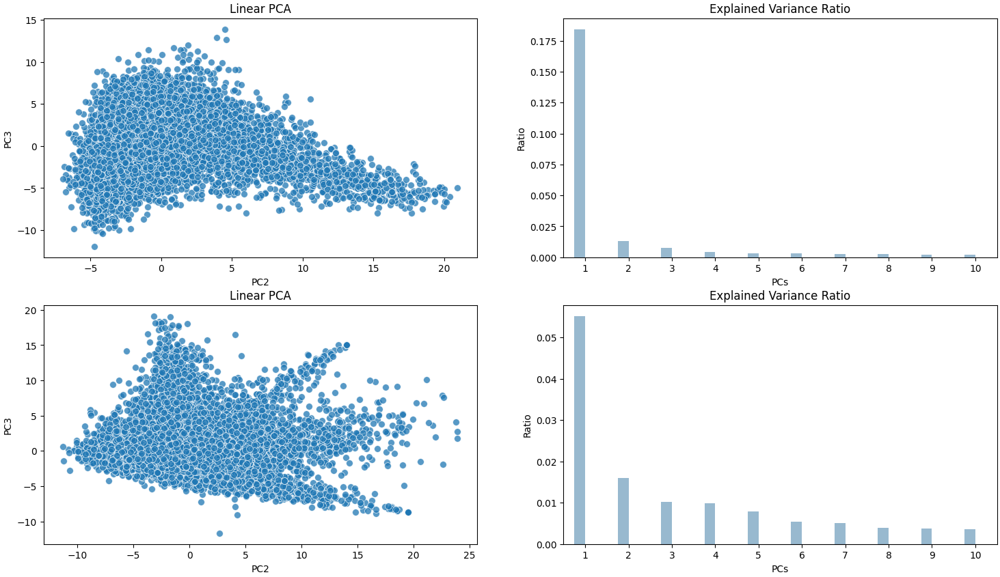

In [16]:
n = 10

df_pca_z, var_ratio_z = pca_wrapper_region(df_cf_double_z.T,
                                            n = n)

df_pca_standard, var_ratio_standard = pca_wrapper_region(df_cf_standard.T,
                                                          n = n)

fig, axes = plt.subplots(2,2, figsize=(18,10))

with plt.style.context('_classic_test_patch'):

    
    ## first row = double-z
    sns.scatterplot(x = "PC2",
                    y = "PC3",
                    data = df_pca_z,
                    s = 50,
                    alpha = 0.75,
                    palette="Set1",
                    ax = axes[0,0])

    axes[0,0].set_title("Linear PCA", fontsize=12)
    axes[0,0].set_xlabel("PC2", fontsize=10)
    axes[0,0].set_ylabel("PC3", fontsize=10)
    
    
    sns.barplot(x = list(range(1, n+1)),
                    y = var_ratio_z,
                    width = 0.25,
                    alpha = 0.5,
                    align = "center",
                    ax = axes[0,1])
    
    axes[0,1].set_title("Explained Variance Ratio", fontsize=12)
    axes[0,1].set_xlabel("PCs", fontsize=10)
    axes[0,1].set_ylabel("Ratio", fontsize=10)

    ## second row = standard
    sns.scatterplot(x = "PC2",
                    y = "PC3",
                    data = df_pca_standard,
                    s = 50,
                    alpha = 0.75,
                    palette="Set1",
                    ax = axes[1,0])

    axes[1,0].set_title("Linear PCA", fontsize=12)
    axes[1,0].set_xlabel("PC2", fontsize=10)
    axes[1,0].set_ylabel("PC3", fontsize=10)
    
    
    sns.barplot(x = list(range(1, n+1)),
                    y = var_ratio_standard,
                    width = 0.25,
                    alpha = 0.5,
                    align = "center",
                    ax = axes[1,1])
    
    axes[1,1].set_title("Explained Variance Ratio", fontsize=12)
    axes[1,1].set_xlabel("PCs", fontsize=10)
    axes[1,1].set_ylabel("Ratio", fontsize=10)

#### Regions of Interest

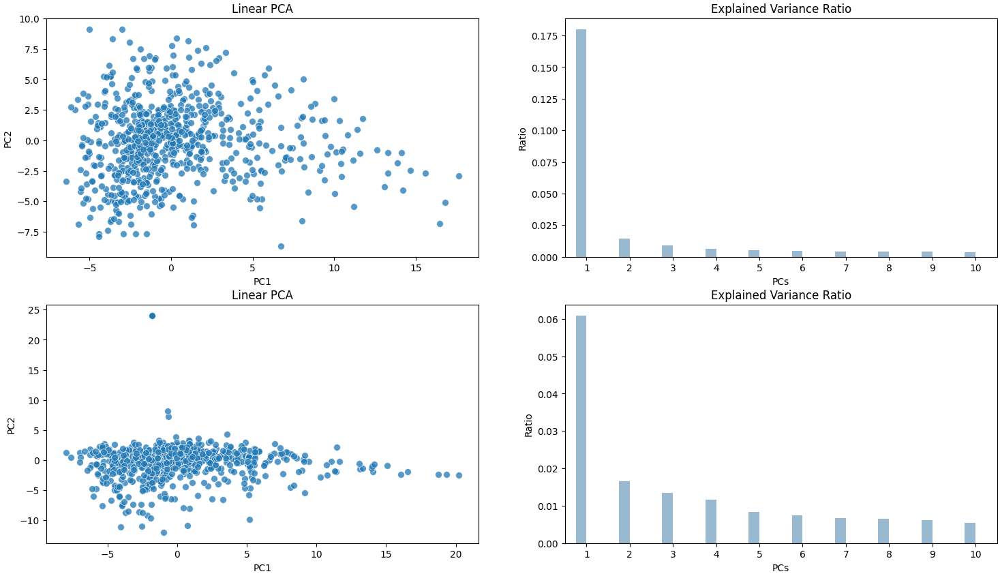

In [17]:
n = 10

df_pca_z, var_ratio_z = pca_wrapper_region(df_cf_double_z_roi.T,
                                            n = n)

df_pca_standard, var_ratio_standard = pca_wrapper_region(df_cf_standard_roi.T,
                                                          n = n)

fig, axes = plt.subplots(2,2, figsize=(18,10))

with plt.style.context('_classic_test_patch'):

    
    ## first row = double-z
    sns.scatterplot(x = "PC2",
                    y = "PC3",
                    data = df_pca_z,
                    s = 50,
                    alpha = 0.75,
                    palette="Set1",
                    ax = axes[0,0])

    axes[0,0].set_title("Linear PCA", fontsize=12)
    axes[0,0].set_xlabel("PC1", fontsize=10)
    axes[0,0].set_ylabel("PC2", fontsize=10)
    
    
    sns.barplot(x = list(range(1, n+1)),
                    y = var_ratio_z,
                    width = 0.25,
                    alpha = 0.5,
                    align = "center",
                    ax = axes[0,1])
    
    axes[0,1].set_title("Explained Variance Ratio", fontsize=12)
    axes[0,1].set_xlabel("PCs", fontsize=10)
    axes[0,1].set_ylabel("Ratio", fontsize=10)

    ## second row = standard
    sns.scatterplot(x = "PC2",
                    y = "PC3",
                    data = df_pca_standard,
                    s = 50,
                    alpha = 0.75,
                    palette="Set1",
                    ax = axes[1,0])

    axes[1,0].set_title("Linear PCA", fontsize=12)
    axes[1,0].set_xlabel("PC1", fontsize=10)
    axes[1,0].set_ylabel("PC2", fontsize=10)
    
    
    sns.barplot(x = list(range(1, n+1)),
                    y = var_ratio_standard,
                    width = 0.25,
                    alpha = 0.5,
                    align = "center",
                    ax = axes[1,1])
    
    axes[1,1].set_title("Explained Variance Ratio", fontsize=12)
    axes[1,1].set_xlabel("PCs", fontsize=10)
    axes[1,1].set_ylabel("Ratio", fontsize=10)

## Linear PCA + UMAP

- Use standard scaling or double-z scores
- Perform linear PCA and use the top 10-20 PCs
- Perform UMAP in the PC-space

### Samples

In [18]:
## Remove positive control regions

umap_cf_z, pca_cf_z = umap_wrapper(df_cf_double_z.drop(pos_control_in_s3, axis=1),
                                   df_cf_meta,
                                   n_pca=15,
                                   remove_PC1=False,
                                   n_neighbors=10,
                                   n_umap=3,
                                   learning_rate=0.1,
                                   min_dist=0.1,
                                   spread=1,
                                   metric="euclidean",
                                   random_state=42)




umap_cf_standard, pca_cf_standard = umap_wrapper(df_cf_standard.drop(pos_control_in_s3, axis=1),
                                                 df_cf_meta,
                                                 n_pca=10,
                                                 remove_PC1=False,
                                                 n_neighbors=15,
                                                 n_umap=3,
                                                 learning_rate=0.1,
                                                 min_dist=0.1,
                                                 spread=1,
                                                 metric="euclidean",
                                                 random_state=42)

Input data dimension: (995, 19093)
Input meta-data dimension: (995, 11)
Dimension after merging: (995, 14)
Input data dimension: (995, 19093)
Input meta-data dimension: (995, 11)
Dimension after merging: (995, 14)


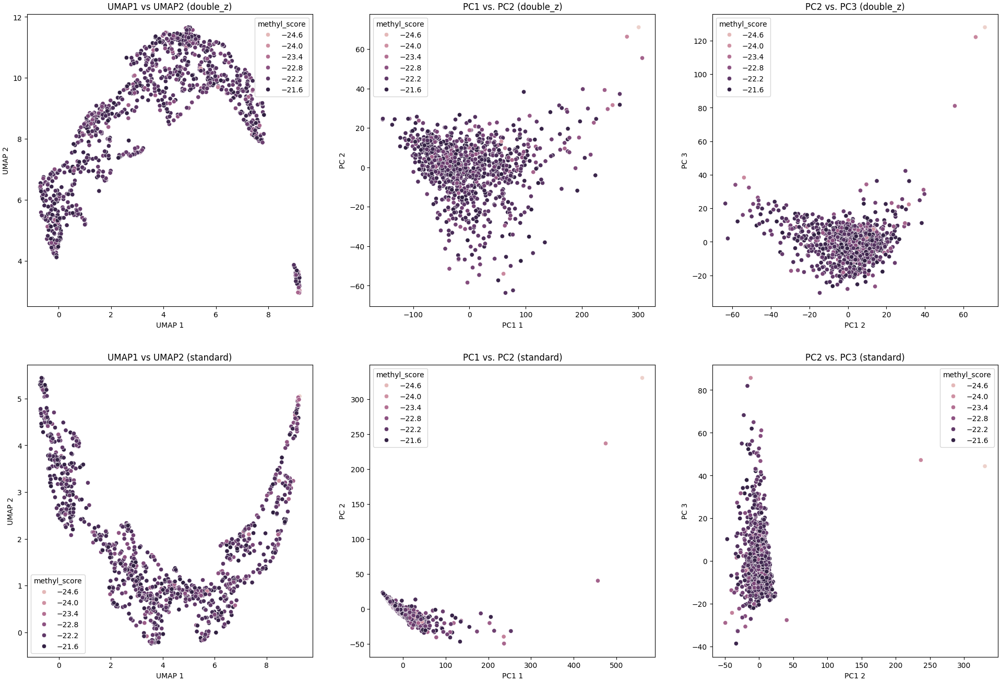

In [19]:
hue = "methyl_score"

fig, axes = plt.subplots(2,3, figsize=(24,16))
with plt.style.context('_classic_test_patch'):

    ## UMAP 1 vs. UMAP 2

    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = hue,
                    data = umap_cf_z,
                    ax = axes[0,0])
        
    axes[0,0].set_title("UMAP1 vs UMAP2 (double_z)", fontsize=12)
    axes[0,0].set_xlabel("UMAP 1", fontsize=10)
    axes[0,0].set_ylabel("UMAP 2", fontsize=10)
    
    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = hue,
                    data = umap_cf_standard,
                    ax = axes[1,0])
        
    axes[1,0].set_title("UMAP1 vs UMAP2 (standard)", fontsize=12)
    axes[1,0].set_xlabel("UMAP 1", fontsize=10)
    axes[1,0].set_ylabel("UMAP 2", fontsize=10)


    
    ## PC 1 vs. PC 2
    sns.scatterplot(x = "PC1",
                    y = "PC2",
                    hue = hue,
                    data = pca_cf_z,
                    ax = axes[0,1])
        
    axes[0,1].set_title("PC1 vs. PC2 (double_z)", fontsize=12)
    axes[0,1].set_xlabel("PC1 1", fontsize=10)
    axes[0,1].set_ylabel("PC 2", fontsize=10)

    
    sns.scatterplot(x = "PC1",
                    y = "PC2",
                    hue = hue,
                    data = pca_cf_standard,
                    ax = axes[1,1])
        
    axes[1,1].set_title("PC1 vs. PC2 (standard)", fontsize=12)
    axes[1,1].set_xlabel("PC1 1", fontsize=10)
    axes[1,1].set_ylabel("PC 2", fontsize=10)
    



    ## PC 2 vs. PC 3
    sns.scatterplot(x = "PC2",
                    y = "PC3",
                    hue = hue,
                    data = pca_cf_z,
                    ax = axes[0,2])
        
    axes[0,2].set_title("PC2 vs. PC3 (double_z)", fontsize=12)
    axes[0,2].set_xlabel("PC1 2", fontsize=10)
    axes[0,2].set_ylabel("PC 3", fontsize=10)
    
    sns.scatterplot(x = "PC2",
                    y = "PC3",
                    hue = hue,
                    data = pca_cf_standard,
                    ax = axes[1,2])
        
    axes[1,2].set_title("PC2 vs. PC3 (standard)", fontsize=12)
    axes[1,2].set_xlabel("PC1 2", fontsize=10)
    axes[1,2].set_ylabel("PC 3", fontsize=10)



### Regions

#### All regions

In [20]:
umap_cf_z_region, pca_cf_z_region = umap_wrapper(df_cf_double_z.T,
                                                   df_meta=region_anno_all,
                                                   n_pca=15,
                                                   remove_PC1=False,
                                                   n_neighbors=15,
                                                   n_umap=3,
                                                   learning_rate=0.1,
                                                   min_dist=0.1,
                                                   spread=1,
                                                   metric="euclidean",
                                                   random_state=42)

umap_cf_standard_region, pca_cf_standard_region = umap_wrapper(df_cf_standard.T,
                                                                 df_meta=region_anno_all,
                                                                 n_pca=15,
                                                                 remove_PC1=False,
                                                                 n_neighbors=15,
                                                                 n_umap=3,
                                                                 learning_rate=0.1,
                                                                 min_dist=0.1,
                                                                 spread=1,
                                                                 metric="euclidean",
                                                                 random_state=42)

Input data dimension: (19134, 995)
Input meta-data dimension: (19134, 4)
Dimension after merging: (19134, 7)
Input data dimension: (19134, 995)
Input meta-data dimension: (19134, 4)
Dimension after merging: (19134, 7)


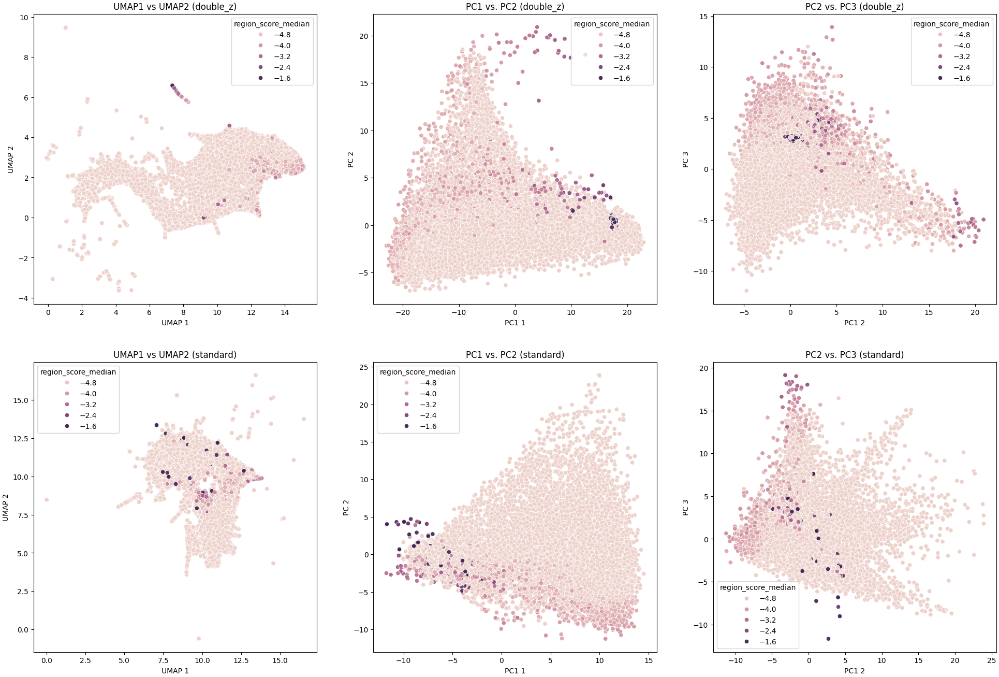

In [21]:
hue = "region_score_median"

fig, axes = plt.subplots(2,3, figsize=(24,16))
with plt.style.context('_classic_test_patch'):

    ## UMAP 1 vs. UMAP 2
    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = hue,
                    data = umap_cf_z_region,
                    ax = axes[0,0])
        
    axes[0,0].set_title("UMAP1 vs UMAP2 (double_z)", fontsize=12)
    axes[0,0].set_xlabel("UMAP 1", fontsize=10)
    axes[0,0].set_ylabel("UMAP 2", fontsize=10)
    
    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = hue,
                    data = umap_cf_standard_region,
                    ax = axes[1,0])
        
    axes[1,0].set_title("UMAP1 vs UMAP2 (standard)", fontsize=12)
    axes[1,0].set_xlabel("UMAP 1", fontsize=10)
    axes[1,0].set_ylabel("UMAP 2", fontsize=10)


    ## PC 1 vs. PC 2
    sns.scatterplot(x = "PC1",
                    y = "PC2",
                    hue = hue,
                    data = pca_cf_z_region,
                    ax = axes[0,1])
        
    axes[0,1].set_title("PC1 vs. PC2 (double_z)", fontsize=12)
    axes[0,1].set_xlabel("PC1 1", fontsize=10)
    axes[0,1].set_ylabel("PC 2", fontsize=10)

    
    sns.scatterplot(x = "PC1",
                    y = "PC2",
                    hue = hue,
                    data = pca_cf_standard_region,
                    ax = axes[1,1])
        
    axes[1,1].set_title("PC1 vs. PC2 (standard)", fontsize=12)
    axes[1,1].set_xlabel("PC1 1", fontsize=10)
    axes[1,1].set_ylabel("PC 2", fontsize=10)



    ## PC 2 vs. PC 3
    sns.scatterplot(x = "PC2",
                    y = "PC3",
                    hue = hue,
                    data = pca_cf_z_region,
                    ax = axes[0,2])
        
    axes[0,2].set_title("PC2 vs. PC3 (double_z)", fontsize=12)
    axes[0,2].set_xlabel("PC1 2", fontsize=10)
    axes[0,2].set_ylabel("PC 3", fontsize=10)
    
    sns.scatterplot(x = "PC2",
                    y = "PC3",
                    hue = hue,
                    data = pca_cf_standard_region,
                    ax = axes[1,2])
        
    axes[1,2].set_title("PC2 vs. PC3 (standard)", fontsize=12)
    axes[1,2].set_xlabel("PC1 2", fontsize=10)
    axes[1,2].set_ylabel("PC 3", fontsize=10)


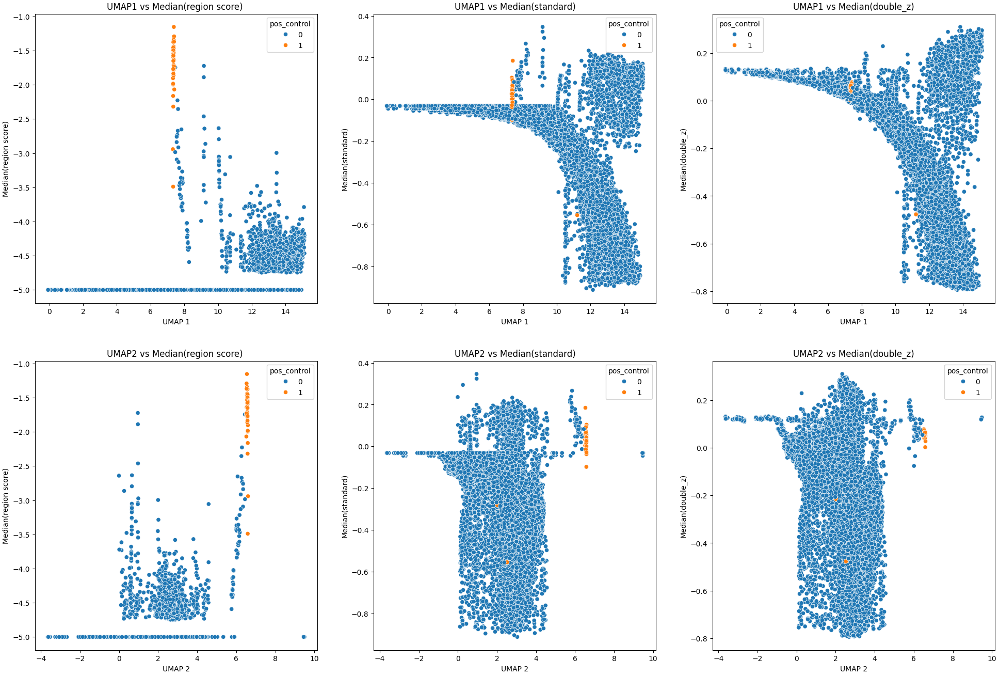

In [22]:
## Check the correlation between (UMAP1 & UMAP2) with coverage
## Use double-z scores + UMAP

hue = "pos_control"

fig, axes = plt.subplots(2,3, figsize=(24,16))
with plt.style.context('_classic_test_patch'):

    ## UMAP1 vs. region score median
    sns.scatterplot(x = "UMAP1",
                    y = "region_score_median",
                    hue = hue,
                    data = umap_cf_z_region,
                    ax = axes[0,0])
        
    axes[0,0].set_title("UMAP1 vs Median(region score) ", fontsize=12)
    axes[0,0].set_xlabel("UMAP 1", fontsize=10)
    axes[0,0].set_ylabel("Median(region score)", fontsize=10)

    ## UMAP1 vs. standard scaling median
    sns.scatterplot(x = "UMAP1",
                    y = "standard_median",
                    hue = hue,
                    data = umap_cf_z_region,
                    ax = axes[0,1])
        
    axes[0,1].set_title("UMAP1 vs Median(standard)", fontsize=12)
    axes[0,1].set_xlabel("UMAP 1", fontsize=10)
    axes[0,1].set_ylabel("Median(standard)", fontsize=10)

    ## UMAP1 vs. double z
    sns.scatterplot(x = "UMAP1",
                    y = "double_z_median",
                    hue = hue,
                    data = umap_cf_z_region,
                    ax = axes[0,2])
        
    axes[0,2].set_title("UMAP1 vs Median(double_z)", fontsize=12)
    axes[0,2].set_xlabel("UMAP 1", fontsize=10)
    axes[0,2].set_ylabel("Median(double_z)", fontsize=10)

    
    
    ## UMAP2 vs. region score median
    sns.scatterplot(x = "UMAP2",
                    y = "region_score_median",
                    hue = hue,
                    data = umap_cf_z_region,
                    ax = axes[1,0])
        
    axes[1,0].set_title("UMAP2 vs Median(region score) ", fontsize=12)
    axes[1,0].set_xlabel("UMAP 2", fontsize=10)
    axes[1,0].set_ylabel("Median(region score)", fontsize=10)

    ## UMAP2 vs. standard scaling median
    sns.scatterplot(x = "UMAP2",
                    y = "standard_median",
                    hue = hue,
                    data = umap_cf_z_region,
                    ax = axes[1,1])
        
    axes[1,1].set_title("UMAP2 vs Median(standard)", fontsize=12)
    axes[1,1].set_xlabel("UMAP 2", fontsize=10)
    axes[1,1].set_ylabel("Median(standard)", fontsize=10)

    ## UMAP2 vs. double z
    sns.scatterplot(x = "UMAP2",
                    y = "double_z_median",
                    hue = hue,
                    data = umap_cf_z_region,
                    ax = axes[1,2])
        
    axes[1,2].set_title("UMAP2 vs Median(double_z)", fontsize=12)
    axes[1,2].set_xlabel("UMAP 2", fontsize=10)
    axes[1,2].set_ylabel("Median(double_z)", fontsize=10)

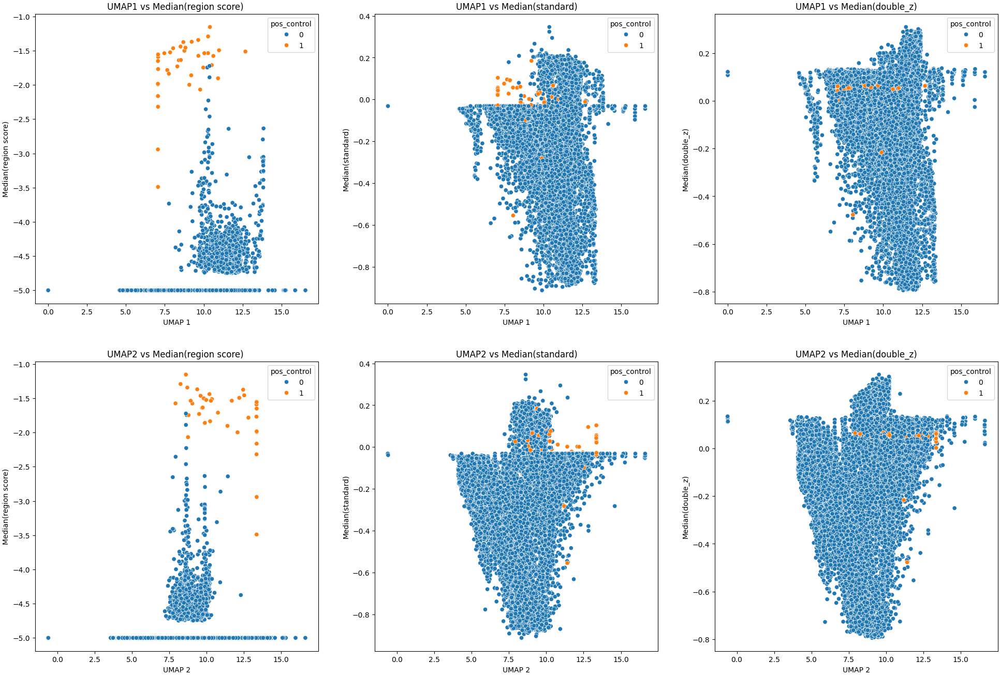

In [23]:
## Check the correlation between (UMAP1 & UMAP2) with coverage
## Use standard scaling + UMAP

hue = "pos_control"

fig, axes = plt.subplots(2,3, figsize=(24,16))
with plt.style.context('_classic_test_patch'):

    ## UMAP1 vs. region score median
    sns.scatterplot(x = "UMAP1",
                    y = "region_score_median",
                    hue = hue,
                    data = umap_cf_standard_region,
                    ax = axes[0,0])
        
    axes[0,0].set_title("UMAP1 vs Median(region score) ", fontsize=12)
    axes[0,0].set_xlabel("UMAP 1", fontsize=10)
    axes[0,0].set_ylabel("Median(region score)", fontsize=10)

    ## UMAP1 vs. standard scaling median
    sns.scatterplot(x = "UMAP1",
                    y = "standard_median",
                    hue = hue,
                    data = umap_cf_standard_region,
                    ax = axes[0,1])
        
    axes[0,1].set_title("UMAP1 vs Median(standard)", fontsize=12)
    axes[0,1].set_xlabel("UMAP 1", fontsize=10)
    axes[0,1].set_ylabel("Median(standard)", fontsize=10)

    ## UMAP1 vs. double z
    sns.scatterplot(x = "UMAP1",
                    y = "double_z_median",
                    hue = hue,
                    data = umap_cf_standard_region,
                    ax = axes[0,2])
        
    axes[0,2].set_title("UMAP1 vs Median(double_z)", fontsize=12)
    axes[0,2].set_xlabel("UMAP 1", fontsize=10)
    axes[0,2].set_ylabel("Median(double_z)", fontsize=10)

    
    
    ## UMAP2 vs. region score median
    sns.scatterplot(x = "UMAP2",
                    y = "region_score_median",
                    hue = hue,
                    data = umap_cf_standard_region,
                    ax = axes[1,0])
        
    axes[1,0].set_title("UMAP2 vs Median(region score) ", fontsize=12)
    axes[1,0].set_xlabel("UMAP 2", fontsize=10)
    axes[1,0].set_ylabel("Median(region score)", fontsize=10)

    ## UMAP2 vs. standard scaling median
    sns.scatterplot(x = "UMAP2",
                    y = "standard_median",
                    hue = hue,
                    data = umap_cf_standard_region,
                    ax = axes[1,1])
        
    axes[1,1].set_title("UMAP2 vs Median(standard)", fontsize=12)
    axes[1,1].set_xlabel("UMAP 2", fontsize=10)
    axes[1,1].set_ylabel("Median(standard)", fontsize=10)

    ## UMAP2 vs. double z
    sns.scatterplot(x = "UMAP2",
                    y = "double_z_median",
                    hue = hue,
                    data = umap_cf_standard_region,
                    ax = axes[1,2])
        
    axes[1,2].set_title("UMAP2 vs Median(double_z)", fontsize=12)
    axes[1,2].set_xlabel("UMAP 2", fontsize=10)
    axes[1,2].set_ylabel("Median(double_z)", fontsize=10)

#### Regions of interest

In [24]:
umap_cf_z_region_roi, pca_cf_z_region_roi = umap_wrapper(df_cf_double_z_roi.T,
                                                         df_meta=region_anno,
                                                         n_pca=15,
                                                         remove_PC1=False,
                                                         n_neighbors=10,
                                                         n_umap=3,
                                                         learning_rate=0.1,
                                                         min_dist=0.1,
                                                         spread=1,
                                                        metric="euclidean",
                                                        random_state=42)

umap_cf_standard_region_roi, pca_cf_standard_region_roi = umap_wrapper(df_cf_standard_roi.T,
                                                                       df_meta=region_anno,
                                                                       n_pca=15,
                                                                       remove_PC1=False,
                                                                       n_neighbors=10,
                                                                       n_umap=3,
                                                                       learning_rate=0.1,
                                                                       min_dist=0.1,
                                                                       spread=1,
                                                                       metric="euclidean",
                                                                       random_state=42)

Input data dimension: (827, 995)
Input meta-data dimension: (1028, 19)
Dimension after merging: (827, 22)
Input data dimension: (827, 995)
Input meta-data dimension: (1028, 19)
Dimension after merging: (827, 22)


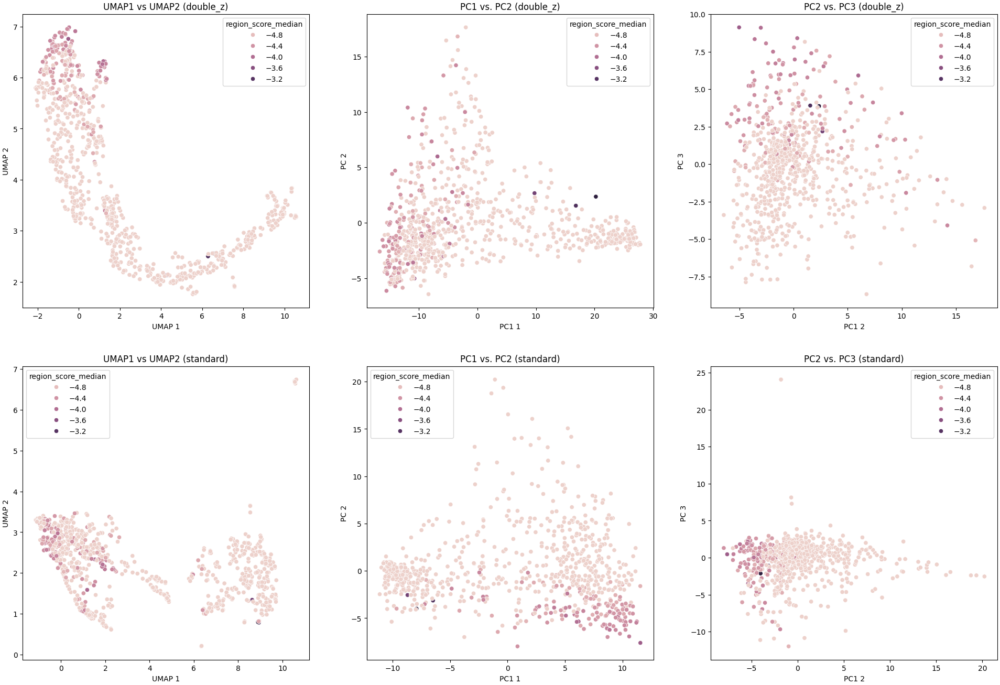

In [25]:
hue = "region_score_median"

fig, axes = plt.subplots(2,3, figsize=(24,16))
with plt.style.context('_classic_test_patch'):

    ## UMAP 1 vs. UMAP 2

    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = hue,
                    data = umap_cf_z_region_roi,
                    ax = axes[0,0])
        
    axes[0,0].set_title("UMAP1 vs UMAP2 (double_z)", fontsize=12)
    axes[0,0].set_xlabel("UMAP 1", fontsize=10)
    axes[0,0].set_ylabel("UMAP 2", fontsize=10)
    
    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = hue,
                    data = umap_cf_standard_region_roi,
                    ax = axes[1,0])
        
    axes[1,0].set_title("UMAP1 vs UMAP2 (standard)", fontsize=12)
    axes[1,0].set_xlabel("UMAP 1", fontsize=10)
    axes[1,0].set_ylabel("UMAP 2", fontsize=10)



    ## PC 1 vs. PC 2
    sns.scatterplot(x = "PC1",
                    y = "PC2",
                    hue = hue,
                    data = pca_cf_z_region_roi,
                    ax = axes[0,1])
        
    axes[0,1].set_title("PC1 vs. PC2 (double_z)", fontsize=12)
    axes[0,1].set_xlabel("PC1 1", fontsize=10)
    axes[0,1].set_ylabel("PC 2", fontsize=10)

    
    sns.scatterplot(x = "PC1",
                    y = "PC2",
                    hue = hue,
                    data = pca_cf_standard_region_roi,
                    ax = axes[1,1])
        
    axes[1,1].set_title("PC1 vs. PC2 (standard)", fontsize=12)
    axes[1,1].set_xlabel("PC1 1", fontsize=10)
    axes[1,1].set_ylabel("PC 2", fontsize=10)



    ## PC 2 vs. PC 3
    sns.scatterplot(x = "PC2",
                    y = "PC3",
                    hue = hue,
                    data = pca_cf_z_region_roi,
                    ax = axes[0,2])
        
    axes[0,2].set_title("PC2 vs. PC3 (double_z)", fontsize=12)
    axes[0,2].set_xlabel("PC1 2", fontsize=10)
    axes[0,2].set_ylabel("PC 3", fontsize=10)
    
    sns.scatterplot(x = "PC2",
                    y = "PC3",
                    hue = hue,
                    data = pca_cf_standard_region_roi,
                    ax = axes[1,2])
        
    axes[1,2].set_title("PC2 vs. PC3 (standard)", fontsize=12)
    axes[1,2].set_xlabel("PC1 2", fontsize=10)
    axes[1,2].set_ylabel("PC 3", fontsize=10)

In [26]:
umap_cf_z_region_roi.corr()

,sens_threshold,lod,log_lod,snr_p15,snr_p30,snr_p50,snr_p80,snr_p90,snr_p98,snr_p100,region_score_median,standard_median,double_z_median,pos_control,UMAP1,UMAP2,UMAP3
sens_threshold,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
lod,NaN,1.000000,0.980156,0.170095,0.094075,0.024863,-0.092557,-0.117869,-0.300132,-0.490277,0.005288,0.245170,0.260131,NaN,0.337320,-0.202198,0.012259
log_lod,NaN,0.980156,1.000000,0.146391,0.076420,0.012171,-0.096763,-0.120330,-0.293345,-0.476209,0.019654,0.218723,0.231148,NaN,0.289808,-0.157451,0.046588
snr_p15,NaN,0.170095,0.146391,1.000000,0.771968,0.594642,0.350663,0.307211,0.065592,-0.093799,-0.159227,0.293739,0.351320,NaN,0.678180,-0.300493,-0.083619
snr_p30,NaN,0.094075,0.076420,0.771968,1.000000,0.785755,0.490482,0.438637,0.162976,-0.000155,-0.125701,0.220531,0.268911,NaN,0.546960,-0.196518,-0.013869
snr_p50,NaN,0.024863,0.012171,0.594642,0.785755,1.000000,0.643083,0.580850,0.261427,0.087423,-0.101000,0.159466,0.200400,NaN,0.435494,-0.119006,0.024888
snr_p80,NaN,-0.092557,-0.096763,0.350663,0.490482,0.643083,1.000000,0.912588,0.481175,0.273166,-0.066586,0.060228,0.080751,NaN,0.210285,-0.056777,0.026216
snr_p90,NaN,-0.117869,-0.120330,0.307211,0.438637,0.580850,0.912588,1.000000,0.541928,0.325433,-0.059886,0.040524,0.057321,NaN,0.168078,-0.039564,0.029330
snr_p98,NaN,-0.300132,-0.293345,0.065592,0.162976,0.261427,0.481175,0.541928,1.000000,0.679979,-0.032417,-0.074503,-0.078159,NaN,-0.088689,0.043262,-0.020770
snr_p100,NaN,-0.490277,-0.476209,-0.093799,-0.000155,0.087423,0.273166,0.325433,0.679979,1.000000,-0.020288,-0.171075,-0.188821,NaN,-0.270737,0.117038,-0.023791


## K-Means + Elbow Method on UMAP (on doulbe-z scores)

### Samples

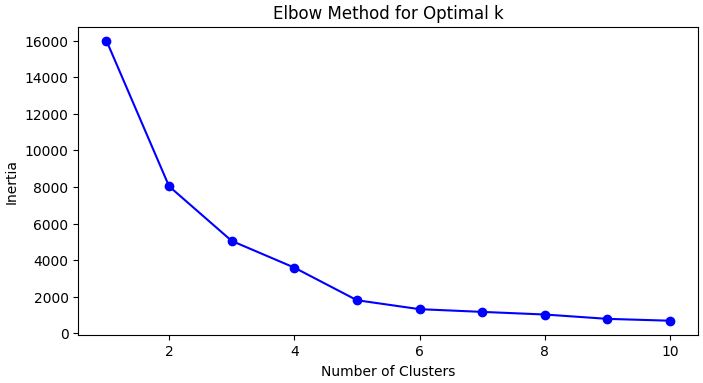

In [27]:
max_k = 10

X_cf_z = umap_cf_z.drop(pdata_cf,axis=1)

## Use elbow method to find the optimal number of clusters
inertia = []

for k in range(1,max_k+1):
    kmeans = KMeans(n_clusters=k, random_state=42).fit(X_cf_z)
    inertia.append(kmeans.inertia_)

fig, axes = plt.subplots(figsize=(8,4))

with plt.style.context('_classic_test_patch'):
    axes.plot(range(1, max_k+1),inertia, 'bo-')
    axes.set_xlabel("Number of Clusters")
    axes.set_ylabel("Inertia")
    axes.set_title("Elbow Method for Optimal k")

In [28]:
run = False
file_name = '/screening/notebooks/zhuang/summer_2024/data/' + "X_cf_z.pkl"

if run:
    ## Use optimal k for k-means
    optimal_k = 4
    kmeans = KMeans(n_clusters=optimal_k, random_state=42).fit(X_cf_z)
    X_cf_z['kmeans_cluster'] = kmeans.fit_predict(X_cf_z.values)
    
    ## DBSCAN
    dbscan = DBSCAN(eps=0.5, min_samples=5)
    X_cf_z['dbscan_cluster'] = dbscan.fit_predict(X_cf_z.values)
            
    with open(file_name, 'wb') as f:
        pickle.dump(X_cf_z, f)

else:
    with open(file_name, 'rb') as f:
        X_cf_z = pickle.load(f)

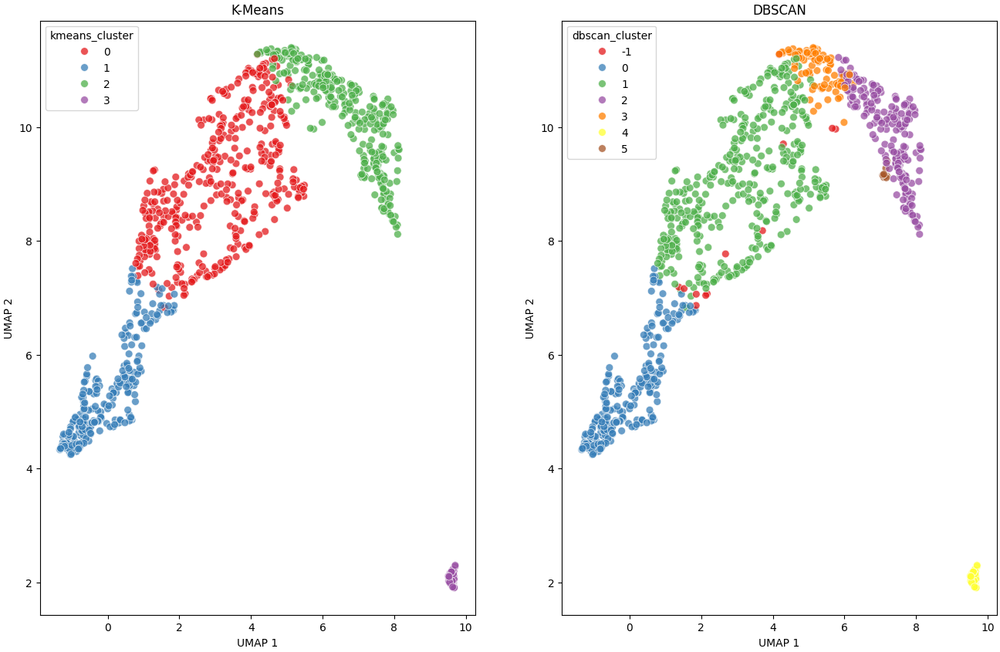

In [29]:
fig, axes = plt.subplots(1,2, figsize=(16,10))

with plt.style.context('_classic_test_patch'):
    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = "kmeans_cluster",
                    data = X_cf_z,
                    s = 50,
                    alpha = 0.75,
                    palette="Set1",
                    ax = axes[0])
    
    axes[0].set_title("K-Means", fontsize=12)
    axes[0].set_xlabel("UMAP 1", fontsize=10)
    axes[0].set_ylabel("UMAP 2", fontsize=10)

    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = "dbscan_cluster",
                    data = X_cf_z,
                    s = 50,
                    alpha = 0.75,
                    palette="Set1",
                    ax = axes[1])
    
    axes[1].set_title("DBSCAN", fontsize=12)
    axes[1].set_xlabel("UMAP 1", fontsize=10)
    axes[1].set_ylabel("UMAP 2", fontsize=10)

In [30]:
## convert cluster label to string
X_cf_z['kmeans_cluster'] = X_cf_z['kmeans_cluster'].astype("str")
X_cf_z['dbscan_cluster'] = X_cf_z['dbscan_cluster'].astype("str")

## expression data
df_exprs = df_cf_double_z_roi.T
df_exprs[df_exprs > 5] = 5

## column annotation
df_anno = pd.merge(df_cf_meta, X_cf_z, left_index=True, right_index=True)

## row annotation
region_anno.head()

,sens_threshold,lod,maf_arg,sample_group_cancer,log_lod,sample_group,snr_p15,snr_p30,snr_p50,snr_p80,snr_p90,snr_p98,snr_p100,in_v6,no_molecule,region_score_median,standard_median,double_z_median,pos_control
region_id,,,,,,,,,,,,,,,,,,,
merged_1063,50,0.933,tvf_max_maf_pct,lung,-0.069350,lung,0.021951,0.088778,0.144192,0.203556,0.220116,0.232560,0.235573,yes,no,-5.0,-0.031718,0.080133,0.0
merged_1084,50,0.879,tvf_max_maf_pct,lung,-0.128970,lung,1.566865,1.790218,2.024377,2.172759,2.208378,2.214453,2.234390,yes,no,-5.0,-0.523477,-0.471343,0.0
merged_1114,50,0.953,tvf_max_maf_pct,lung,-0.048140,lung,1.298919,1.611533,1.798833,1.902381,1.930828,1.951325,1.969295,yes,no,-5.0,-0.630055,-0.569908,0.0
merged_1120,50,0.696,tvf_max_maf_pct,lung,-0.362406,lung,2.456439,2.873650,3.254021,3.236376,3.221483,3.185637,3.199183,yes,no,-5.0,-0.466737,-0.412429,0.0
merged_1145,50,0.957,tvf_max_maf_pct,lung,-0.043952,lung,1.679814,2.347190,2.919942,3.302863,3.244055,3.181707,3.217006,yes,no,-5.0,-0.219110,-0.161848,0.0


In [31]:
#df_anno.query('kmeans_cluster == "3" ').to_csv("/screening/notebooks/zhuang/summer_2024/data/cancer_free_clustering_k_means_cluster_3.csv")

df_anno.head()

,sample_group,age,sex,histological_subtype,g360_max_maf_pct,tvf_max_maf_pct,tumor_fraction,log_tumor_fraction,methyl_score,threshold,methyl_call,UMAP1,UMAP2,UMAP3,kmeans_cluster,dbscan_cluster
unique_sample_id,,,,,,,,,,,,,,,,
A088494401_231104_A01835_0165_AHK7GVDSX7,cancer_free,34.0,F,colo adenocarcinoma,NaN,NaN,0.000087,-9.348961,-22.121883,-21.3192,0.0,0.660488,5.572017,4.158777,1,0
A079777201_230922_A02056_0046_BHCYNKDSX7,cancer_free,73.0,M,colo adenocarcinoma,NaN,NaN,0.000052,-9.865036,-21.808756,-21.3192,0.0,4.449916,10.974423,4.818014,0,1
A085371001_230922_A02056_0046_BHCYNKDSX7,cancer_free,60.0,M,colo adenocarcinoma,NaN,NaN,0.000087,-9.353458,-22.415353,-21.3192,0.0,0.677816,4.855642,4.737335,1,0
A085436301_230922_A02048_0033_AHF2V3DSX7,cancer_free,62.0,F,colo adenocarcinoma,NaN,NaN,0.004059,-5.506913,-21.509161,-21.3192,0.0,7.657056,9.521816,0.580661,2,2
A085668501_230925_A02048_0034_BHCYMYDSX7,cancer_free,39.0,F,colo adenocarcinoma,NaN,NaN,0.000070,-9.567700,-21.770641,-21.3192,0.0,3.272527,10.596736,5.300169,0,1


Starting plotting HeatmapAnnotations


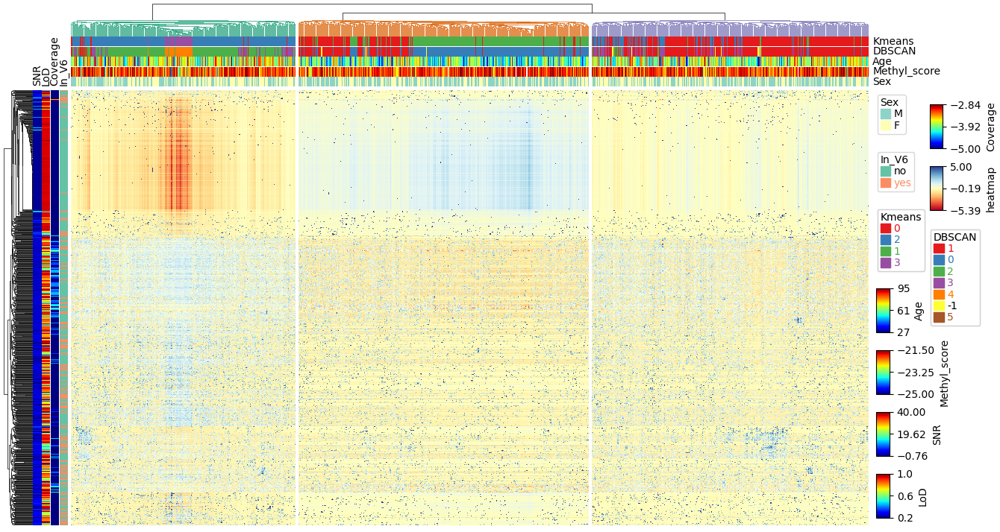

In [32]:
plt.figure(figsize=(15, 8))

# Make annotations for columns/samples
col_annot = pyc.HeatmapAnnotation(Kmeans=pyc.anno_simple(df_anno.kmeans_cluster, cmap='Set1'),
                                  DBSCAN=pyc.anno_simple(df_anno.dbscan_cluster,cmap='Set1'),
                                  Age=pyc.anno_simple(df_anno.age),
                                  Methyl_score=pyc.anno_simple(df_anno.methyl_score),
                                  Sex=pyc.anno_simple(df_anno.sex, cmap='Set3'),axis=1, 
                                  
                                  verbose=False)

# make annotations for regions/rows
#region_annot = pd.DataFrame(index=cgp_sandbox_cancer_type.index.values)
#region_annot['region_type'] = ['v6' if 'merged' in x else 's3' for x in region_annot.index]
row_annot = pyc.HeatmapAnnotation(SNR=pyc.anno_simple(region_anno.snr_p100),
                                  LoD=pyc.anno_simple(region_anno.lod),
                                  Coverage=pyc.anno_simple(region_anno.region_score_median),
                                  In_V6=pyc.anno_simple(region_anno.in_v6, cmap='Set2'),axis=0)

cm = pyc.ClusterMapPlotter(data=df_exprs, 
                           top_annotation=col_annot, 
                           left_annotation=row_annot,
                           cmap='RdYlBu', 
                           col_dendrogram=True,  
                           row_dendrogram=True,  
                           tree_kws={'col_cmap': 'Dark2'}, 
                           col_split=3, 
                           col_split_gap=1, 
                           row_cluster_method='complete', 
                           col_cluster_method='complete', 
                           verbose=False)

plt.show()

In [ ]:
df_anno =  df_anno.\
    assign(log10_tumor_fraction = lambda df: np.log10(df["tumor_fraction"]))

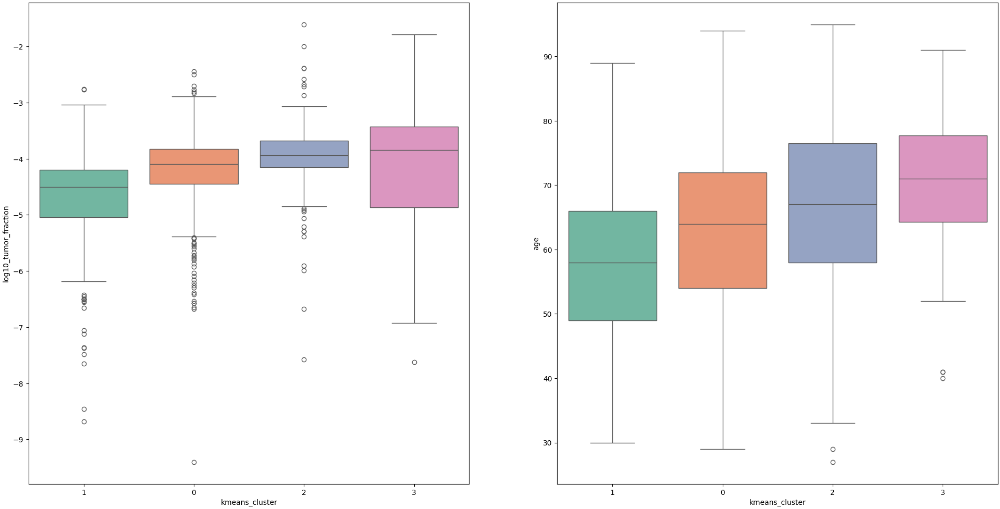

In [38]:
## Meta-info distribution across clusters

fig, axes = plt.subplots(1,2,figsize=(24,12))

with plt.style.context('_classic_test_patch'):

    sns.boxplot(data = df_anno,
                x = 'kmeans_cluster',
                y = 'log10_tumor_fraction',
                ax = axes[0],
                palette = 'Set2')

    sns.boxplot(data = df_anno,
                x = 'kmeans_cluster',
                y = 'age',
                ax = axes[1],
                palette = 'Set2')


In [48]:
cf_region_and_kmeans = pd.merge(df_cf_region, df_anno.loc[:,["sample_group", "kmeans_cluster"]], how="left",left_index=True,right_index=True)
cf_region_and_kmeans.shape

(995, 19136)

In [49]:
with open('/screening/notebooks/zhuang/summer_2024/data/cf_region_and_kmeans', 'wb') as f:
        pickle.dump(cf_region_and_kmeans, f)

In [ ]:
## Meta-info distribution across clusters

fig, axes = plt.subplots(2,3,figsize=(18,10))

with plt.style.context('_classic_test_patch'):

    sns.boxplot(data = df_anno,
                x = 'dbscan_cluster',
                y = 'log_tumor_fraction',
                ax = axes[0,0],
                palette = 'Set2')

    axes[0,0].set_title(" Log(tumor_fraction) ",fontsize=12)
    axes[0,0].set_xlabel(" DBSCAN Cluster ")

    sns.boxplot(data = df_anno,
                x = 'dbscan_cluster',
                y = 'methyl_score',
                ax = axes[0,1],
                palette = 'Set2')

    axes[0,1].set_title(" Methyl_score ",fontsize=12)
    axes[0,1].set_xlabel(" DBSCAN Cluster ")

    sns.boxplot(data = df_anno,
                x = 'dbscan_cluster',
                y = 'age',
                ax = axes[0,2],
                palette = 'Set2')

    axes[0,2].set_title(" Age ",fontsize=12)
    axes[0,2].set_xlabel(" DBSCAN Cluster ")

    sns.boxplot(data = df_anno,
                x = 'kmeans_cluster',
                y = 'log_tumor_fraction',
                ax = axes[1,0],
                palette = 'Set2')

    axes[1,0].set_title(" Log(tumor_fraction) ",fontsize=12)
    axes[1,0].set_xlabel(" K-Means Cluster ")

    sns.boxplot(data = df_anno,
                x = 'kmeans_cluster',
                y = 'methyl_score',
                ax = axes[1,1],
                palette = 'Set2')

    axes[1,1].set_title(" Methyl_score ",fontsize=12)
    axes[1,1].set_xlabel(" K-Means Cluster ")

    sns.boxplot(data = df_anno,
                x = 'kmeans_cluster',
                y = 'age',
                ax = axes[1,2],
                palette = 'Set2')

    axes[1,2].set_title(" Age ",fontsize=12)
    axes[1,2].set_xlabel(" K-Means Cluster ")

In [114]:
run = False

if run:

    for label in X_cf_z.dbscan_cluster.unique():
        print(label)
        if label != "-1":
            samples_of_interest = X_cf_z.query(' dbscan_cluster == @label ').index

            df_flt = df_cf.loc[samples_of_interest,:].\
                drop(pdata_cf,axis=1)

            ## drop regions whose values are -5 across all samples
            no_molecule = [col for col in df_flt.columns if (df_flt[col]==-5).all()]

            print(f"There are {len(no_molecule)} regions with no molecules")

            ## compute pair-wise correlation
            region_corr_sp = df_flt.drop(no_molecule,axis=1).\
                 corr(method="spearman")
    
            print(region_corr_sp.shape)
            
            #region_sp_triu = region_corr_sp.values[np.triu_indices_from(region_corr_sp, k=1)]
    
            sample_corr_sp = df_cf.loc[samples_of_interest,:].\
                drop(pdata_cf,axis=1).\
                drop(no_molecule,axis=1).\
                T.\
                corr(method="spearman")

            #sample_sp_triu = sample_corr_sp.values[np.triu_indices_from(sample_corr_sp, k=1)]
    
            print(sample_corr_sp.shape)
    
            region_file_name = '/screening/notebooks/zhuang/summer_2024/data/' + "region_corr_sp_" + "dbscan_cluster_" + label + ".pkl"
    
            sample_file_name = '/screening/notebooks/zhuang/summer_2024/data/' + "sample_corr_sp_" + "dbscan_cluster_" + label + ".pkl"
            
            with open(region_file_name, 'wb') as f:
                pickle.dump(region_corr_sp, f)
    
            print("region correlation saved!")
    
            with open(sample_file_name, 'wb') as f:
                pickle.dump(sample_corr_sp, f)
    
            print("sample correlation saved!")

In [115]:
run = False

if run:

    for label in X_cf_z.kmeans_cluster.unique():
        print(label)
        if label != "-1":
            samples_of_interest = X_cf_z.query(' kmeans_cluster == @label ').index

            df_flt = df_cf.loc[samples_of_interest,:].\
                drop(pdata_cf,axis=1)

            ## drop regions whose values are -5 across all samples
            no_molecule = [col for col in df_flt.columns if (df_flt[col]==-5).all()]

            print(f"There are {len(no_molecule)} regions with no molecules")

            ## compute pair-wise correlation
            region_corr_sp = df_flt.drop(no_molecule,axis=1).\
                 corr(method="spearman")
    
            print(region_corr_sp.shape)
            
            #region_sp_triu = region_corr_sp.values[np.triu_indices_from(region_corr_sp, k=1)]
    
            sample_corr_sp = df_cf.loc[samples_of_interest,:].\
                drop(pdata_cf,axis=1).\
                drop(no_molecule,axis=1).\
                T.\
                corr(method="spearman")

            #sample_sp_triu = sample_corr_sp.values[np.triu_indices_from(sample_corr_sp, k=1)]
    
            print(sample_corr_sp.shape)
    
            region_file_name = '/screening/notebooks/zhuang/summer_2024/data/' + "region_corr_sp_" + "kmeans_cluster_" + label + ".pkl"
    
            sample_file_name = '/screening/notebooks/zhuang/summer_2024/data/' + "sample_corr_sp_" + "kmeans_cluster_" + label + ".pkl"
            
            with open(region_file_name, 'wb') as f:
                pickle.dump(region_corr_sp, f)
    
            print("region correlation saved!")
    
            with open(sample_file_name, 'wb') as f:
                pickle.dump(sample_corr_sp, f)
    
            print("sample correlation saved!")

In [123]:
region_corr_sp_dict = {}
sample_corr_sp_dict = {}

for label in  X_cf_z.dbscan_cluster.unique():
    
    if label != "-1":
        
        region_file_name = '/screening/notebooks/zhuang/summer_2024/data/' + "region_corr_sp_" + "dbscan_cluster_" + label + ".pkl"
        sample_file_name = '/screening/notebooks/zhuang/summer_2024/data/' + "sample_corr_sp_" + "dbscan_cluster_" + label + ".pkl"

        with open(region_file_name , 'rb') as f:
            region_corr_sp_dict["dbscan_cluster_" + label] = pickle.load(f)

        with open(sample_file_name , 'rb') as f:
            sample_corr_sp_dict["dbscan_cluster_" + label] = pickle.load(f)


for label in  X_cf_z.kmeans_cluster.unique():
    if label != "-1":
        
        region_file_name = '/screening/notebooks/zhuang/summer_2024/data/' + "region_corr_sp_" + "kmeans_cluster_" + label + ".pkl"
        sample_file_name = '/screening/notebooks/zhuang/summer_2024/data/' + "sample_corr_sp_" + "kmeans_cluster_" + label + ".pkl"

        with open(region_file_name , 'rb') as f:
            region_corr_sp_dict["kmeans_cluster_" + label] = pickle.load(f)

        with open(sample_file_name , 'rb') as f:
            sample_corr_sp_dict["kmeans_cluster_" + label] = pickle.load(f)

dbscan_cluster_0
(679, 19)
Starting plotting HeatmapAnnotations


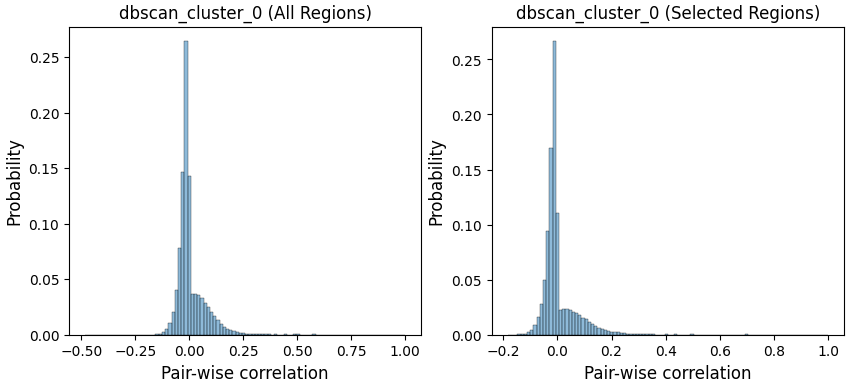

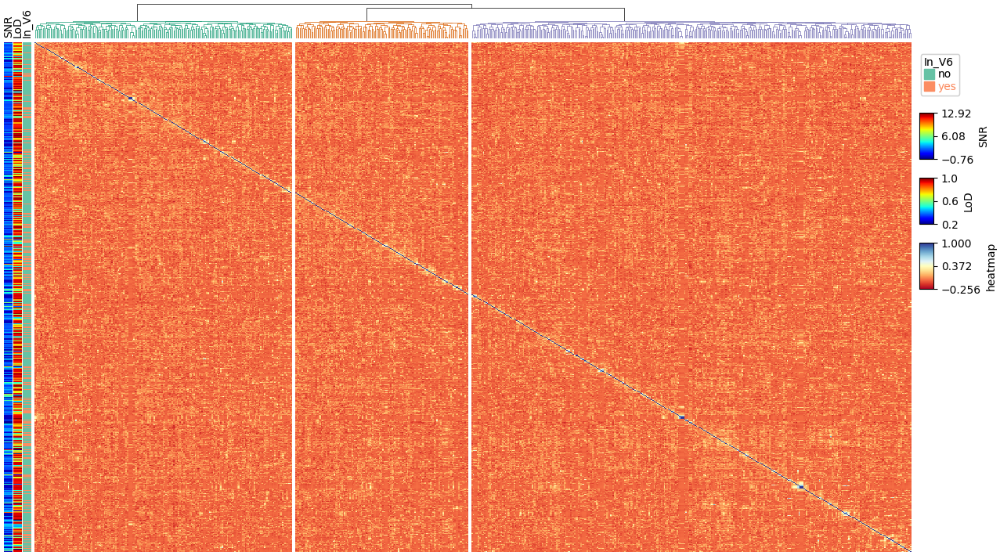

dbscan_cluster_1
(747, 19)
Starting plotting HeatmapAnnotations


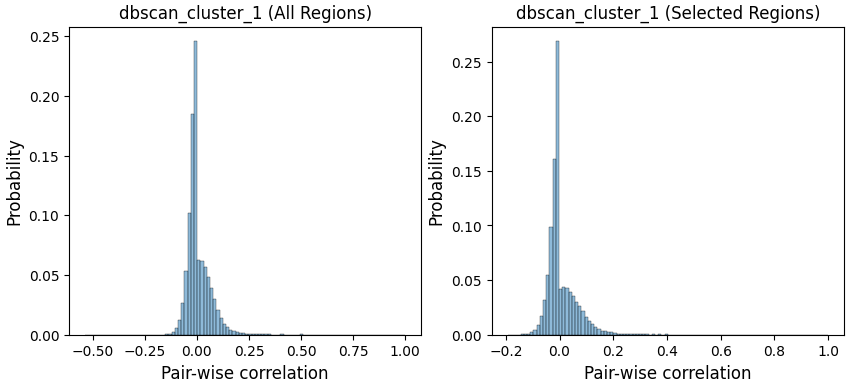

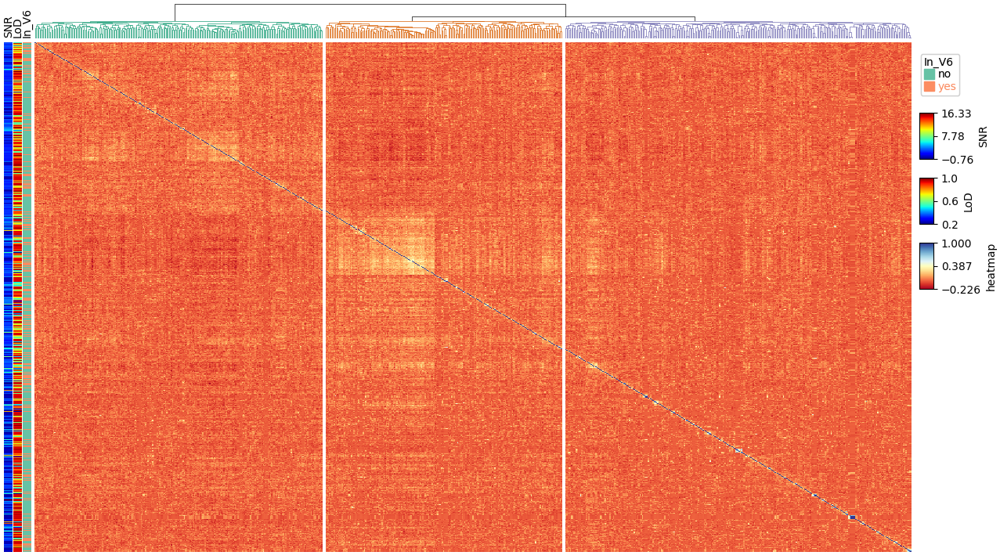

dbscan_cluster_2
(727, 19)
Starting plotting HeatmapAnnotations


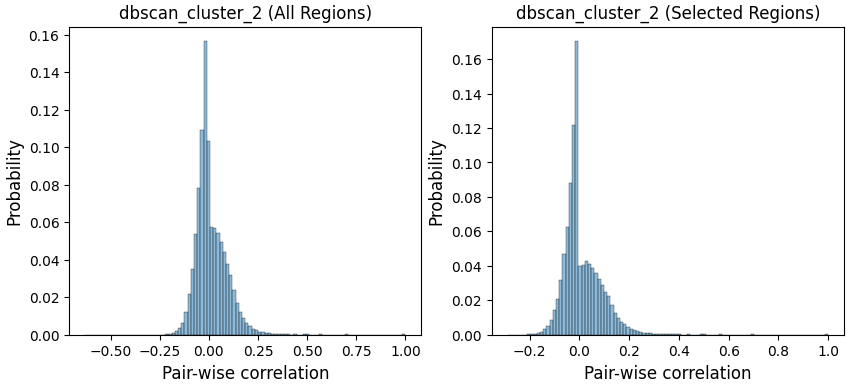

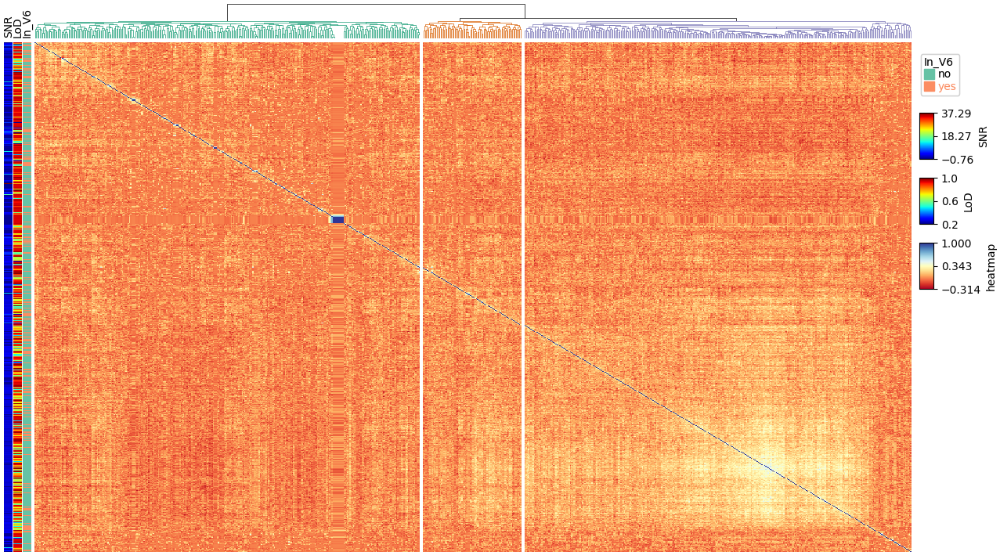

dbscan_cluster_3
(655, 19)
Starting plotting HeatmapAnnotations


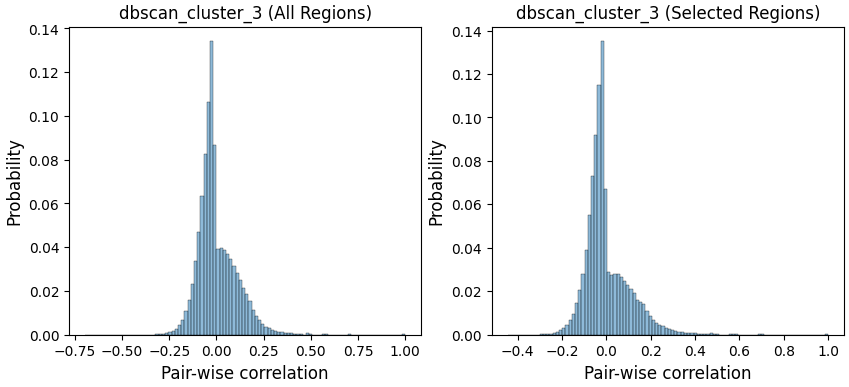

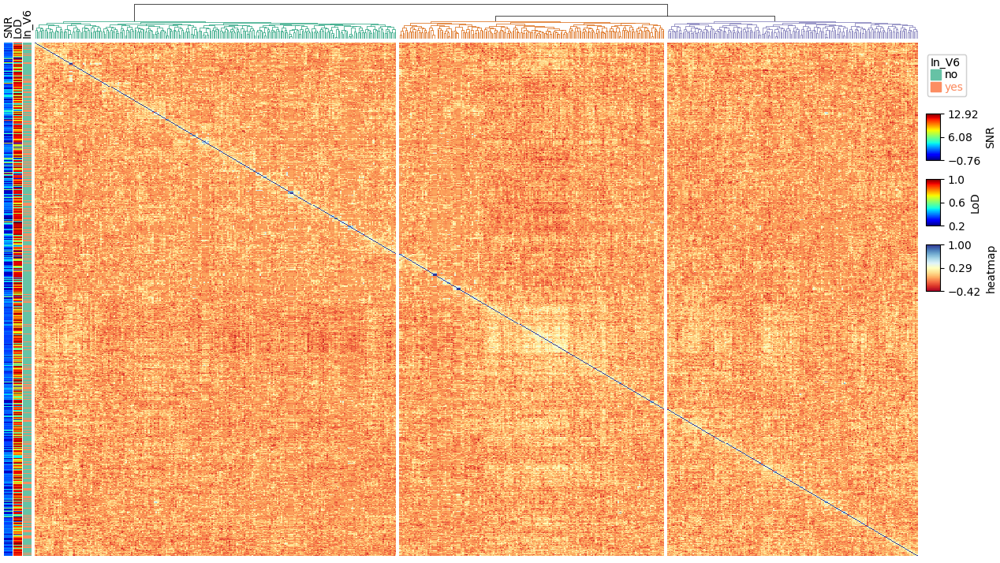

dbscan_cluster_4
(676, 19)
Starting plotting HeatmapAnnotations


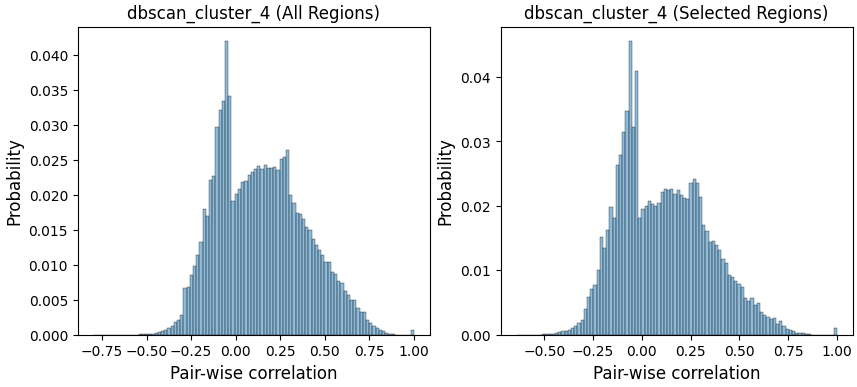

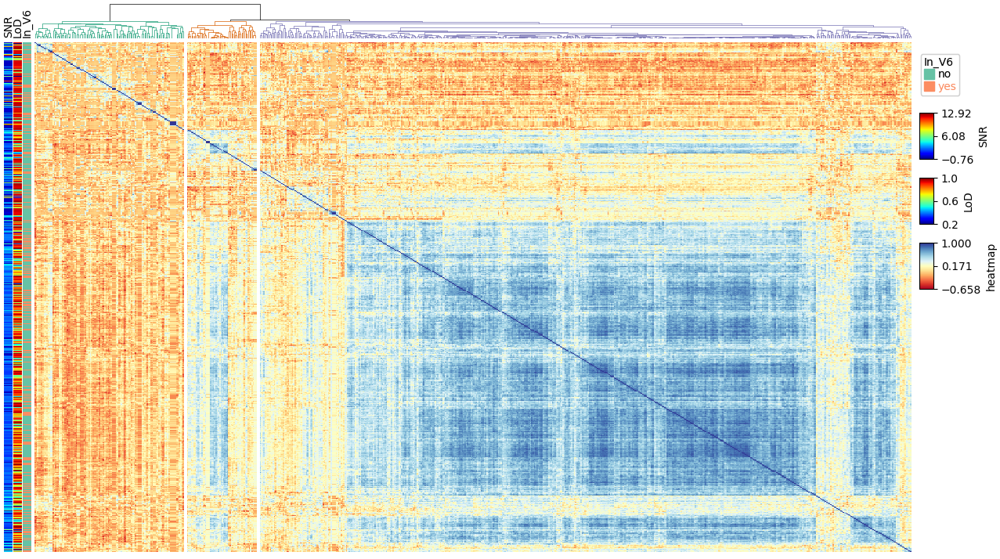

dbscan_cluster_5
(583, 19)
Starting plotting HeatmapAnnotations


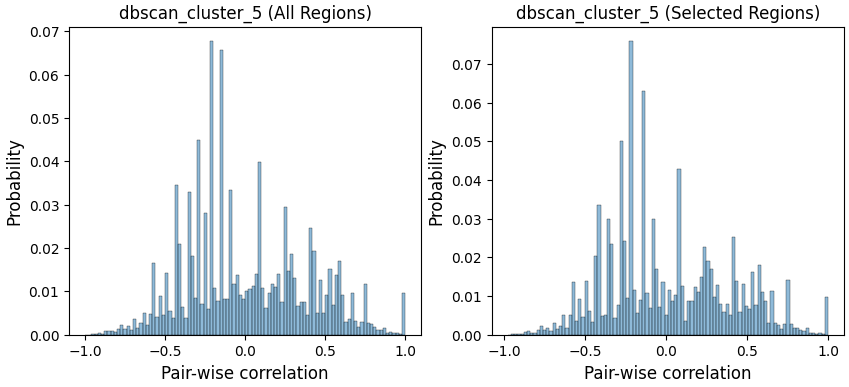

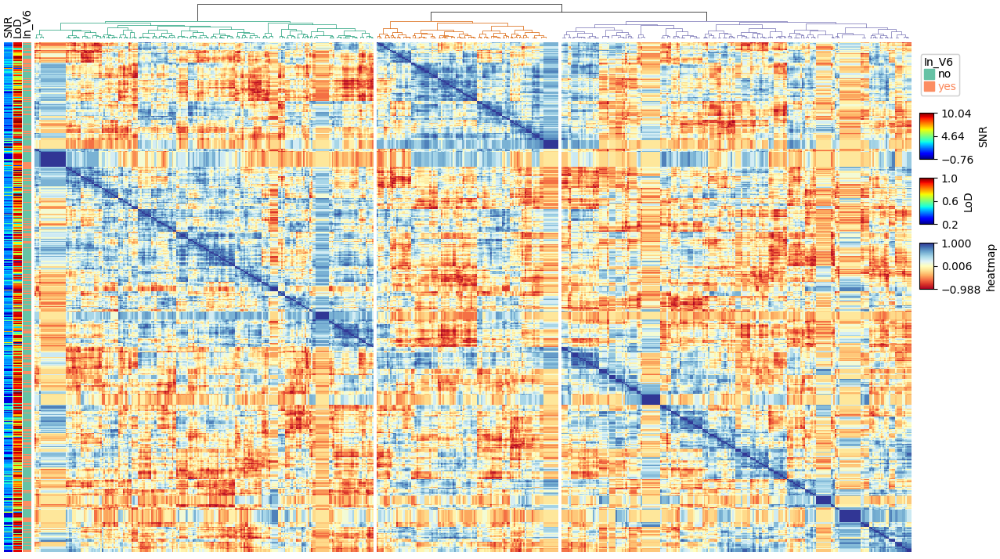

kmeans_cluster_1
(682, 19)
Starting plotting HeatmapAnnotations


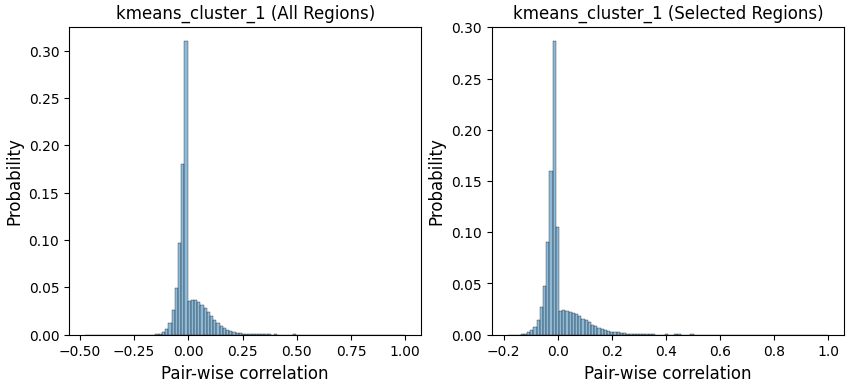

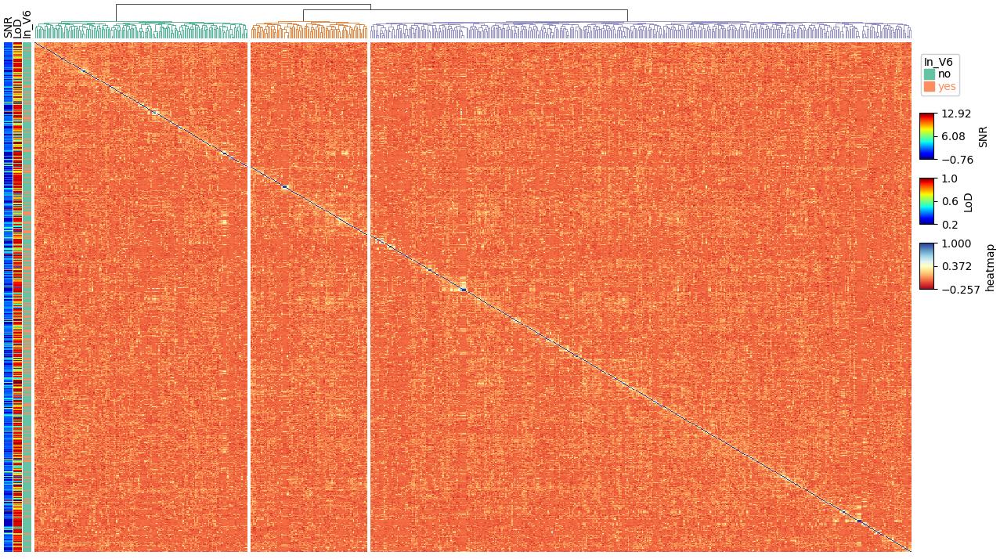

kmeans_cluster_0
(748, 19)
Starting plotting HeatmapAnnotations


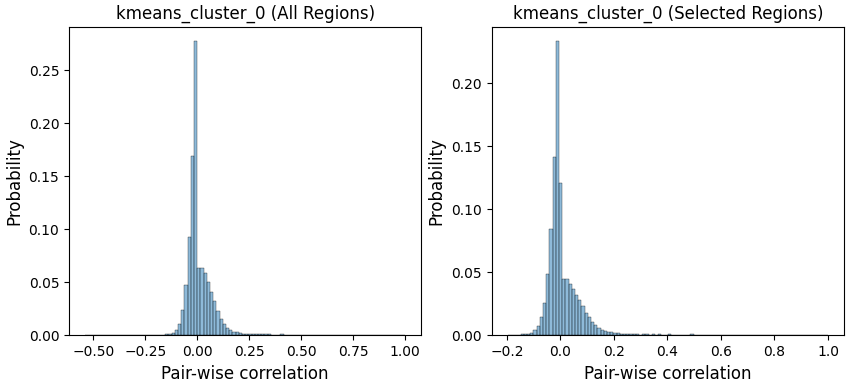

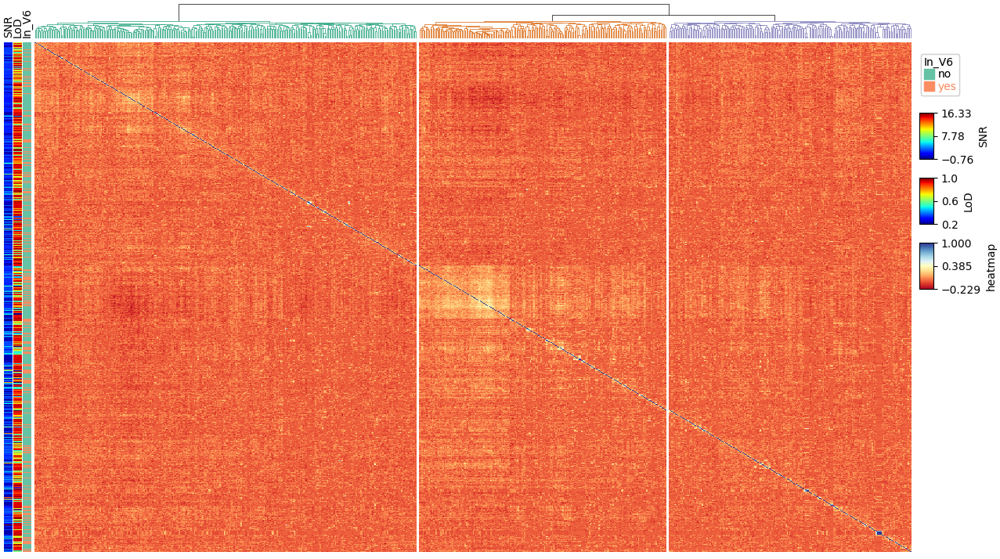

kmeans_cluster_2
(746, 19)
Starting plotting HeatmapAnnotations


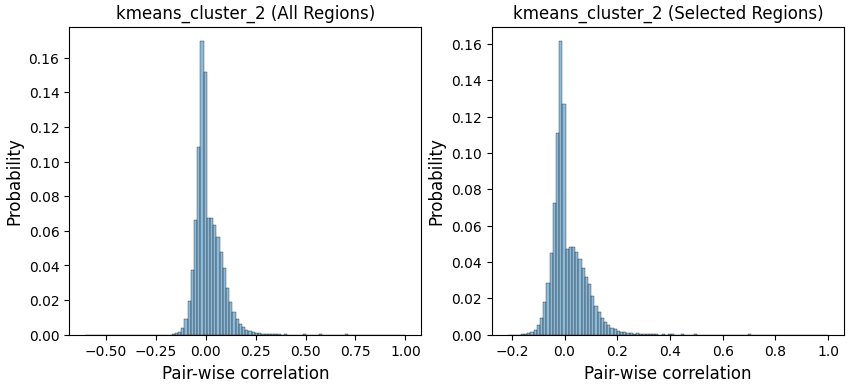

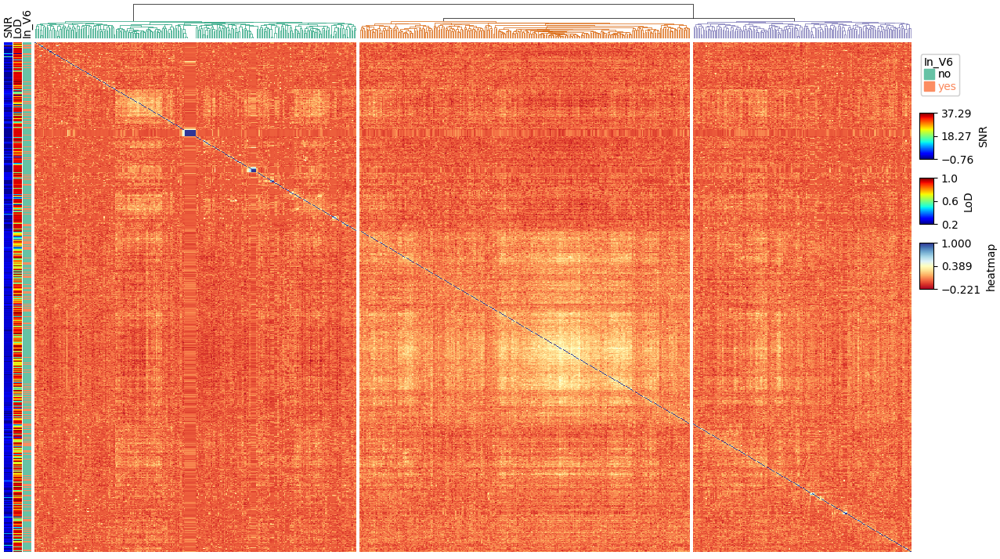

kmeans_cluster_3
(676, 19)
Starting plotting HeatmapAnnotations


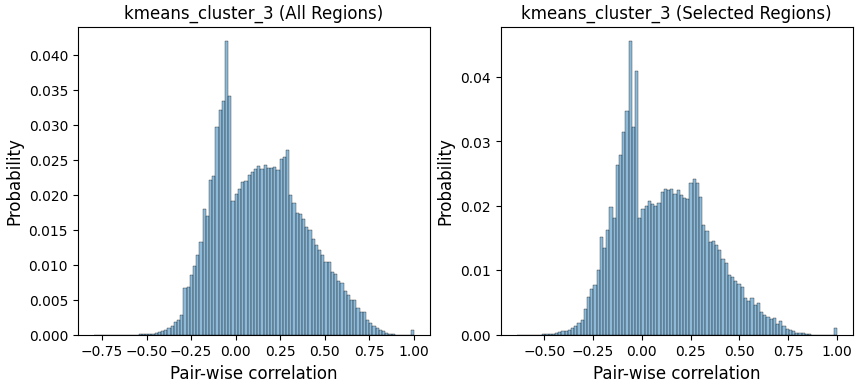

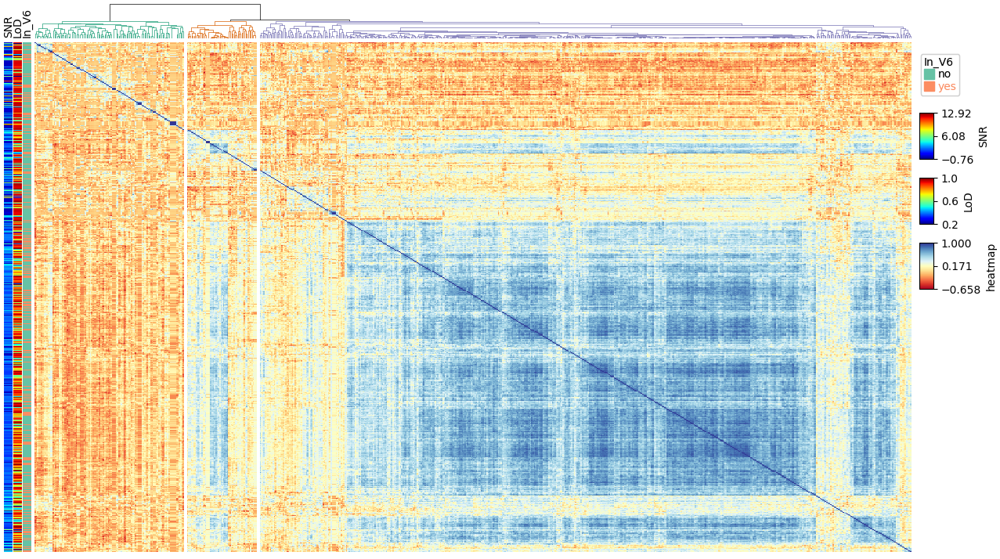

In [124]:
for key, df_corr in region_corr_sp_dict.items():

    print(key)

    ## upper-triangle
    df_corr_triu = df_corr.values[np.triu_indices_from(df_corr, k=1)]
    
    ## subset regions to regions_of_interest
    region_flt = [i for i in regions_of_interest if i in df_corr.columns]

    df_corr_flt = df_corr.loc[region_flt, region_flt]

    df_corr_flt_triu = df_corr.values[np.triu_indices_from(df_corr_flt, k=1)]

    region_anno_flt = region_anno.reset_index().\
    query(' region_id in @region_flt ').\
    set_index("region_id")

    print(region_anno_flt.shape)


    fig, axes = plt.subplots(1,2, figsize=(10,4))
    
    with plt.style.context('_classic_test_patch'):
    
        sns.histplot(df_corr_triu,
                     bins = 100,
                     kde = False,
                     alpha = 0.5,
                     stat = 'probability',
                     ax = axes[0])
    
        axes[0].set_xlabel('Pair-wise correlation', fontsize=12)
        axes[0].set_ylabel('Probability', fontsize=12)
        axes[0].set_title(key + ' (All Regions)', fontsize=12)
    
        sns.histplot(df_corr_flt_triu,
                     bins = 100,
                     kde = False,
                     alpha = 0.5,
                     stat = 'probability',
                     ax = axes[1])
    
        axes[1].set_xlabel('Pair-wise correlation', fontsize=12)
        axes[1].set_ylabel('Probability', fontsize=12)
        axes[1].set_title(key + ' (Selected Regions)', fontsize=12)

    fig.savefig('/screening/notebooks/zhuang/summer_2024/results/' + "region_corr_sp_" + key + "_hist.png", dpi=400)

    
    plt.figure(figsize=(15, 8))


    # make annotations for regions
    col_annot = pyc.HeatmapAnnotation(SNR=pyc.anno_simple(region_anno_flt.snr_p100),
                                      LoD=pyc.anno_simple(region_anno_flt.lod),
                                      In_V6=pyc.anno_simple(region_anno_flt.in_v6, cmap='Set2'),axis=0)
    
    cm = pyc.ClusterMapPlotter(data=df_corr_flt, 
                               left_annotation=col_annot, 
                               cmap='RdYlBu', 
                               col_dendrogram=True,  
                               row_dendrogram=False,  
                               tree_kws={'col_cmap': 'Dark2'}, 
                               col_split=3, 
                               col_split_gap=1, 
                               row_cluster_method='complete', 
                               col_cluster_method='complete', 
                               verbose=False)
    
    plt.show()

    fig.savefig('/screening/notebooks/zhuang/summer_2024/results/' + "region_corr_sp_" + key + "_heatmap.png", dpi=400)
    

### Regions (all regions)

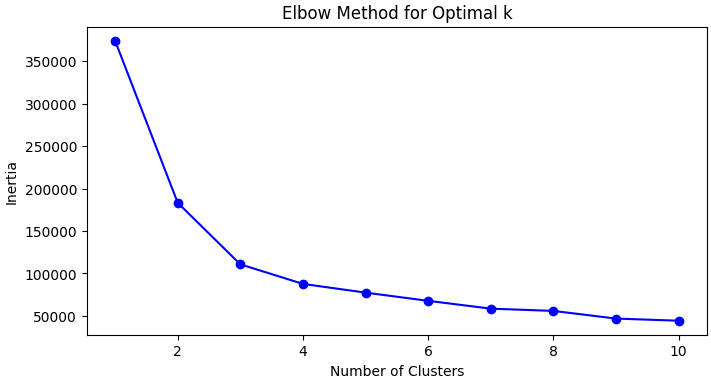

In [125]:
max_k = 10

X_cf_z_region = umap_cf_z_region

## Use elbow method to find the optimal number of clusters
inertia = []

for k in range(1,max_k+1):
    kmeans = KMeans(n_clusters=k, random_state=42).fit(X_cf_z_region)
    inertia.append(kmeans.inertia_)

fig, axes = plt.subplots(figsize=(8,4))

with plt.style.context('_classic_test_patch'):
    axes.plot(range(1, max_k+1),inertia, 'bo-')
    axes.set_xlabel("Number of Clusters")
    axes.set_ylabel("Inertia")
    axes.set_title("Elbow Method for Optimal k")

In [132]:
## Use optimal k for k-means
optimal_k = 3
kmeans = KMeans(n_clusters=optimal_k, random_state=42).fit(X_cf_z_region)
X_cf_z_region['kmeans_cluster'] = kmeans.fit_predict(X_cf_z_region.values)

## DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=30)
X_cf_z_region['dbscan_cluster'] = dbscan.fit_predict(X_cf_z_region.values)

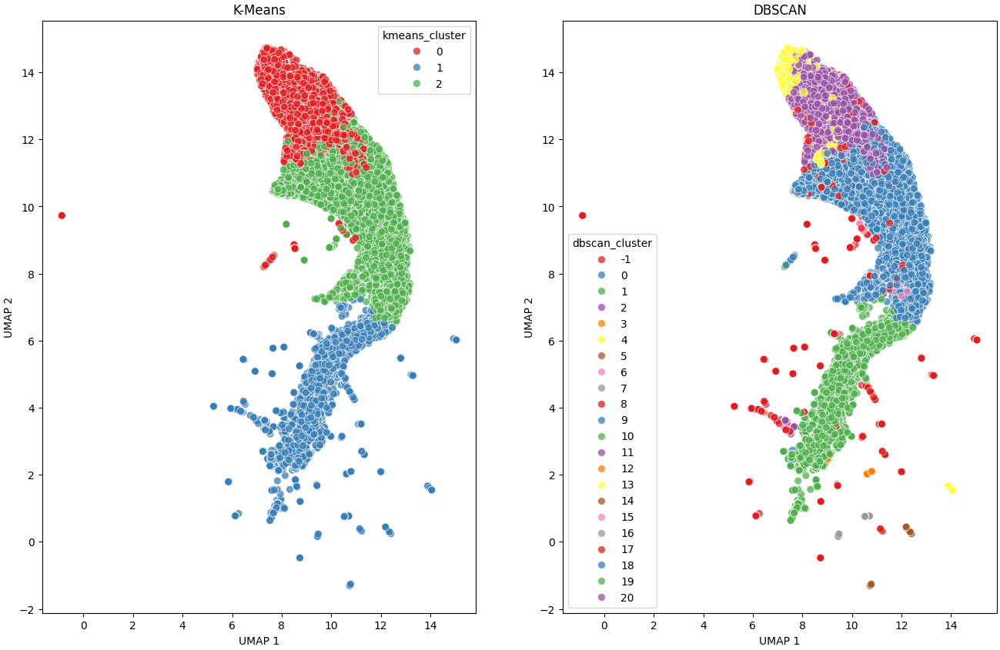

In [136]:
fig, axes = plt.subplots(1,2, figsize=(16,10))

with plt.style.context('_classic_test_patch'):
    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = "kmeans_cluster",
                    data = X_cf_z_region,
                    s = 50,
                    alpha = 0.75,
                    palette="Set1",
                    ax = axes[0])
    
    axes[0].set_title("K-Means", fontsize=12)
    axes[0].set_xlabel("UMAP 1", fontsize=10)
    axes[0].set_ylabel("UMAP 2", fontsize=10)

    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = "dbscan_cluster",
                    data = X_cf_z_region,
                    s = 50,
                    alpha = 0.75,
                    palette="Set1",
                    ax = axes[1])
    
    axes[1].set_title("DBSCAN", fontsize=12)
    axes[1].set_xlabel("UMAP 1", fontsize=10)
    axes[1].set_ylabel("UMAP 2", fontsize=10)

In [137]:
X_cf_z_region.head()

,region_score_median,standard_median,double_z_median,pos_control,UMAP1,UMAP2,UMAP3,kmeans_cluster,dbscan_cluster
s3_region_1,-5.0,-0.174817,-0.145685,0,10.812518,11.910858,5.651159,2,0
s3_region_2,-5.0,-0.078679,0.027538,0,11.849397,6.279477,7.409800,1,1
s3_region_3,-5.0,-0.044522,0.068033,0,9.790221,5.874110,8.491381,1,1
s3_region_4,-5.0,-0.119528,-0.053956,0,11.596021,8.746117,5.277213,2,0
s3_region_6,-5.0,-0.662087,-0.598984,0,8.449603,12.024487,7.279019,0,2


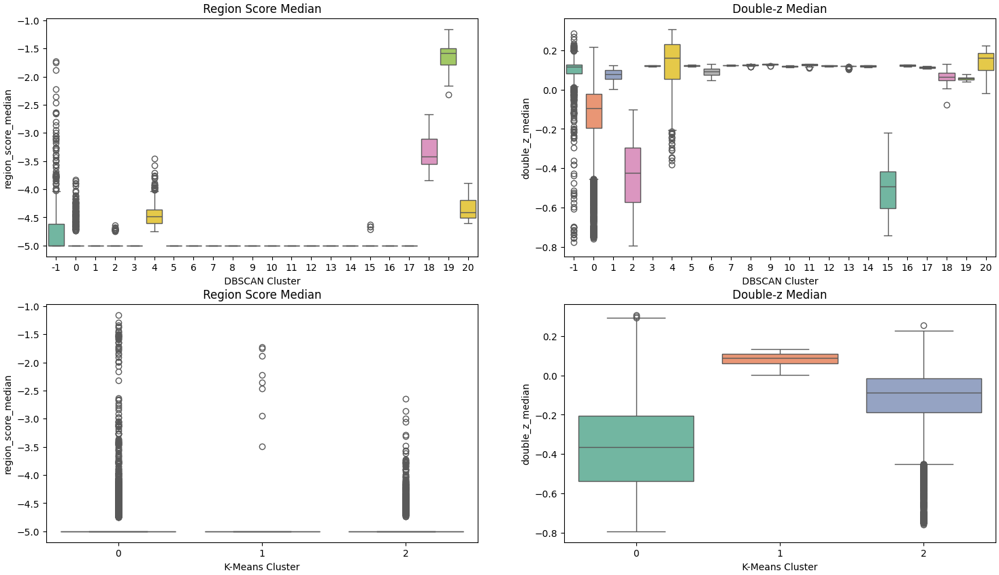

In [139]:
## Meta-info distribution across clusters

fig, axes = plt.subplots(2,2,figsize=(18,10))

with plt.style.context('_classic_test_patch'):

    sns.boxplot(data = X_cf_z_region,
                x = 'dbscan_cluster',
                y = 'region_score_median',
                ax = axes[0,0],
                palette = 'Set2')

    axes[0,0].set_title(" Region Score Median ",fontsize=12)
    axes[0,0].set_xlabel(" DBSCAN Cluster ")

    sns.boxplot(data = X_cf_z_region,
                x = 'dbscan_cluster',
                y = 'double_z_median',
                ax = axes[0,1],
                palette = 'Set2')

    axes[0,1].set_title(" Double-z Median ",fontsize=12)
    axes[0,1].set_xlabel(" DBSCAN Cluster ")


    sns.boxplot(data = X_cf_z_region,
                x = 'kmeans_cluster',
                y = 'region_score_median',
                ax = axes[1,0],
                palette = 'Set2')

    axes[1,0].set_title(" Region Score Median ",fontsize=12)
    axes[1,0].set_xlabel(" K-Means Cluster ")

    sns.boxplot(data = X_cf_z_region,
                x = 'kmeans_cluster',
                y = 'double_z_median',
                ax = axes[1,1],
                palette = 'Set2')

    axes[1,1].set_title(" Double-z Median ",fontsize=12)
    axes[1,1].set_xlabel(" K-Means Cluster ")

### Regions (regions of interest)

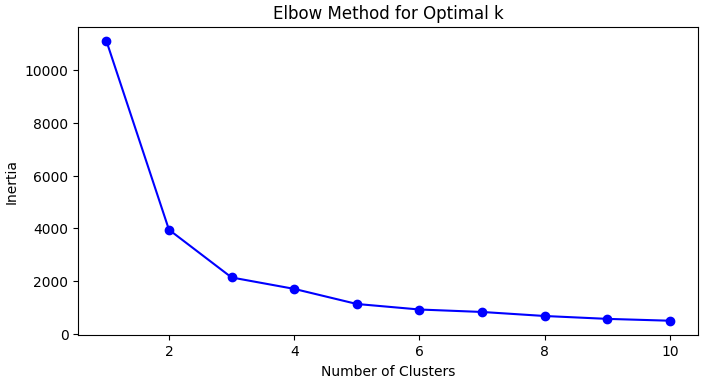

In [140]:
max_k = 10

X_cf_z_region_roi = umap_cf_z_region_roi.drop(region_anno.columns, axis=1)

## Use elbow method to find the optimal number of clusters
inertia = []

for k in range(1,max_k+1):
    kmeans = KMeans(n_clusters=k, random_state=42).fit(X_cf_z_region_roi)
    inertia.append(kmeans.inertia_)

fig, axes = plt.subplots(figsize=(8,4))

with plt.style.context('_classic_test_patch'):
    axes.plot(range(1, max_k+1),inertia, 'bo-')
    axes.set_xlabel("Number of Clusters")
    axes.set_ylabel("Inertia")
    axes.set_title("Elbow Method for Optimal k")

In [141]:
## Use optimal k for k-means
optimal_k = 3
kmeans = KMeans(n_clusters=optimal_k, random_state=42).fit(X_cf_z_region_roi)
X_cf_z_region_roi['kmeans_cluster'] = kmeans.fit_predict(X_cf_z_region_roi.values)

## DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5)
X_cf_z_region_roi['dbscan_cluster'] = dbscan.fit_predict(X_cf_z_region_roi.values)

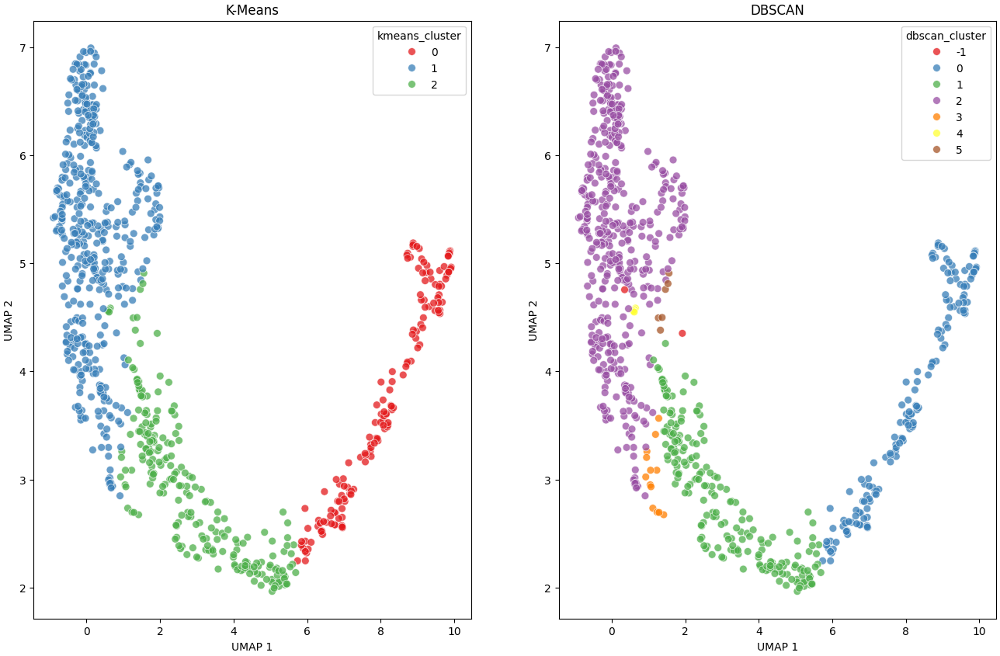

In [142]:
fig, axes = plt.subplots(1,2, figsize=(16,10))

with plt.style.context('_classic_test_patch'):
    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = "kmeans_cluster",
                    data = X_cf_z_region_roi,
                    s = 50,
                    alpha = 0.75,
                    palette="Set1",
                    ax = axes[0])
    
    axes[0].set_title("K-Means", fontsize=12)
    axes[0].set_xlabel("UMAP 1", fontsize=10)
    axes[0].set_ylabel("UMAP 2", fontsize=10)

    sns.scatterplot(x = "UMAP1",
                    y = "UMAP2",
                    hue = "dbscan_cluster",
                    data = X_cf_z_region_roi,
                    s = 50,
                    alpha = 0.75,
                    palette="Set1",
                    ax = axes[1])
    
    axes[1].set_title("DBSCAN", fontsize=12)
    axes[1].set_xlabel("UMAP 1", fontsize=10)
    axes[1].set_ylabel("UMAP 2", fontsize=10)

In [145]:
X_cf_z_region_roi = pd.merge(X_cf_z_region_roi, region_anno, how="left", left_index=True, right_index=True)
X_cf_z_region_roi.head()

,UMAP1,UMAP2,UMAP3,kmeans_cluster,dbscan_cluster,sens_threshold,lod,maf_arg,sample_group_cancer,log_lod,...,snr_p80,snr_p90,snr_p98,snr_p100,in_v6,no_molecule,region_score_median,standard_median,double_z_median,pos_control
merged_1063,7.025715,2.796785,5.212807,0,0,50,0.933,tvf_max_maf_pct,lung,-0.069350,...,0.203556,0.220116,0.232560,0.235573,yes,no,-5.0,-0.031718,0.080133,0.0
merged_1084,1.648163,3.771847,3.805328,2,1,50,0.879,tvf_max_maf_pct,lung,-0.128970,...,2.172759,2.208378,2.214453,2.234390,yes,no,-5.0,-0.523477,-0.471343,0.0
merged_1114,0.259840,6.290326,6.617867,1,2,50,0.953,tvf_max_maf_pct,lung,-0.048140,...,1.902381,1.930828,1.951325,1.969295,yes,no,-5.0,-0.630055,-0.569908,0.0
merged_1120,0.868408,4.695025,6.185090,1,2,50,0.696,tvf_max_maf_pct,lung,-0.362406,...,3.236376,3.221483,3.185637,3.199183,yes,no,-5.0,-0.466737,-0.412429,0.0
merged_1145,1.227569,3.084983,6.413040,2,3,50,0.957,tvf_max_maf_pct,lung,-0.043952,...,3.302863,3.244055,3.181707,3.217006,yes,no,-5.0,-0.219110,-0.161848,0.0


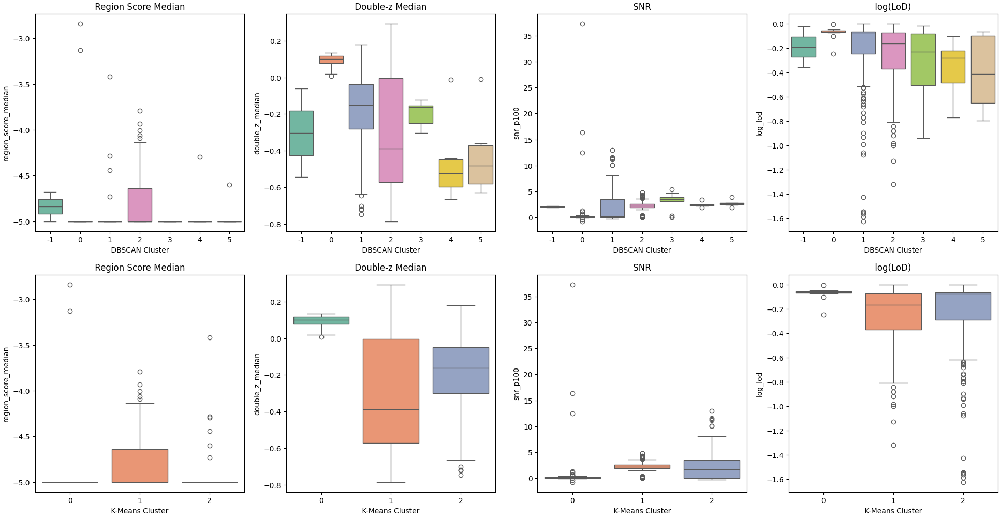

In [150]:
## Meta-info distribution across clusters

fig, axes = plt.subplots(2,4,figsize=(24,12))

with plt.style.context('_classic_test_patch'):

    sns.boxplot(data = X_cf_z_region_roi,
                x = 'dbscan_cluster',
                y = 'region_score_median',
                ax = axes[0,0],
                palette = 'Set2')

    axes[0,0].set_title(" Region Score Median ",fontsize=12)
    axes[0,0].set_xlabel(" DBSCAN Cluster ")

    sns.boxplot(data = X_cf_z_region_roi,
                x = 'dbscan_cluster',
                y = 'double_z_median',
                ax = axes[0,1],
                palette = 'Set2')

    axes[0,1].set_title(" Double-z Median ",fontsize=12)
    axes[0,1].set_xlabel(" DBSCAN Cluster ")

    sns.boxplot(data = X_cf_z_region_roi,
                x = 'dbscan_cluster',
                y = 'snr_p100',
                ax = axes[0,2],
                palette = 'Set2')

    axes[0,2].set_title(" SNR ",fontsize=12)
    axes[0,2].set_xlabel(" DBSCAN Cluster ")

    sns.boxplot(data = X_cf_z_region_roi,
                x = 'dbscan_cluster',
                y = 'log_lod',
                ax = axes[0,3],
                palette = 'Set2')

    axes[0,3].set_title(" log(LoD) ",fontsize=12)
    axes[0,3].set_xlabel(" DBSCAN Cluster ")


    sns.boxplot(data = X_cf_z_region_roi,
                x = 'kmeans_cluster',
                y = 'region_score_median',
                ax = axes[1,0],
                palette = 'Set2')

    axes[1,0].set_title(" Region Score Median ",fontsize=12)
    axes[1,0].set_xlabel(" K-Means Cluster ")

    sns.boxplot(data = X_cf_z_region_roi,
                x = 'kmeans_cluster',
                y = 'double_z_median',
                ax = axes[1,1],
                palette = 'Set2')

    axes[1,1].set_title(" Double-z Median ",fontsize=12)
    axes[1,1].set_xlabel(" K-Means Cluster ")

    sns.boxplot(data = X_cf_z_region_roi,
                x = 'kmeans_cluster',
                y = 'snr_p100',
                ax = axes[1,2],
                palette = 'Set2')

    axes[1,2].set_title(" SNR ",fontsize=12)
    axes[1,2].set_xlabel(" K-Means Cluster ")

    sns.boxplot(data = X_cf_z_region_roi,
                x = 'kmeans_cluster',
                y = 'log_lod',
                ax = axes[1,3],
                palette = 'Set2')

    axes[1,3].set_title(" log(LoD) ",fontsize=12)
    axes[1,3].set_xlabel(" K-Means Cluster ")